<a href="https://colab.research.google.com/github/enappiah/University-of-Hull-projects/blob/master/CO2EMISSIONS_MODELLING_Assessment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
## import the libaries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Building a machine learning model
### The building of machine learning models consist of various steps:
1. Data cleaning and preparation Data visualisation
2. Feature selection
3. Model selection


### Data cleaning and preparation


In [ ]:
### Folder path
PATH = r"/content/drive/MyDrive/Hull University/Understanding AI/labs/"

In [ ]:
# Reading the data
df = pd.read_csv(PATH+'Fuel_Consumption_2010_2014.csv')
#df = pd.read_csv("Fuel_Consumption_2010_2014.csv") # loading the dataset

In [ ]:
df.head()

,Unnamed: 0,MODELYEAR,MAKE,MODEL,VEHICLECLASS,ENGINESIZE,CYLINDERS,TRANSMISSION,FUELTYPE,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
0,0,2010,ACURA,CSX,COMPACT,2.0,4,AS5,X,10.9,7.8,9.5,30.0,219.0
1,1,2010,ACURA,CSX,COMPACT,2.0,4,M5,X,10.0,7.6,8.9,32.0,205.0
2,2,2010,ACURA,CSX,COMPACT,2.0,4,M6,Z,11.6,8.1,10.0,28.0,230.0
3,3,2010,ACURA,MDX AWD,SUV,3.7,6,AS6,Z,14.8,11.3,13.2,21.0,304.0
4,4,2010,ACURA,RDX AWD TURBO,SUV,2.3,4,AS5,Z,13.2,10.3,11.9,24.0,274.0


In [ ]:
df.drop('Unnamed: 0', axis=1, inplace=True)

Plot the model year with the co2 emissions to see how the vehicle model year impacts on the emissions

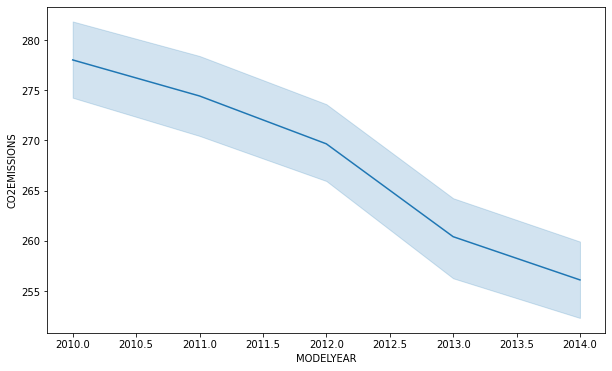

In [ ]:
plt.figure(figsize=(10,6))
sns.lineplot(x = "MODELYEAR", y = "CO2EMISSIONS",data=df)
plt.show()

From the above graph we can say there has been improvement in the emissions from vehicles as the model year increases. This can be the situation of better emissions capture technologies to work on co2 from the vehicles exhaust system.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5359 entries, 0 to 5358
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   MODELYEAR                 5359 non-null   int64  
 1   MAKE                      5359 non-null   object 
 2   MODEL                     5359 non-null   object 
 3   VEHICLECLASS              5359 non-null   object 
 4   ENGINESIZE                5359 non-null   float64
 5   CYLINDERS                 5359 non-null   int64  
 6   TRANSMISSION              5359 non-null   object 
 7   FUELTYPE                  5359 non-null   object 
 8   FUELCONSUMPTION_CITY      5359 non-null   float64
 9   FUELCONSUMPTION_HWY       5359 non-null   float64
 10  FUELCONSUMPTION_COMB      5359 non-null   float64
 11  FUELCONSUMPTION_COMB_MPG  5359 non-null   float64
 12  CO2EMISSIONS              5359 non-null   float64
dtypes: float64(6), int64(2), object(5)
memory usage: 544.4+ KB


### Detecting missing values

In [ ]:
df.isna().sum() #checking for null values

MODELYEAR                   0
MAKE                        0
MODEL                       0
VEHICLECLASS                0
ENGINESIZE                  0
CYLINDERS                   0
TRANSMISSION                0
FUELTYPE                    0
FUELCONSUMPTION_CITY        0
FUELCONSUMPTION_HWY         0
FUELCONSUMPTION_COMB        0
FUELCONSUMPTION_COMB_MPG    0
CO2EMISSIONS                0
dtype: int64

Since there are no missing values for each variable we have a clean dataset

Checking the distribution

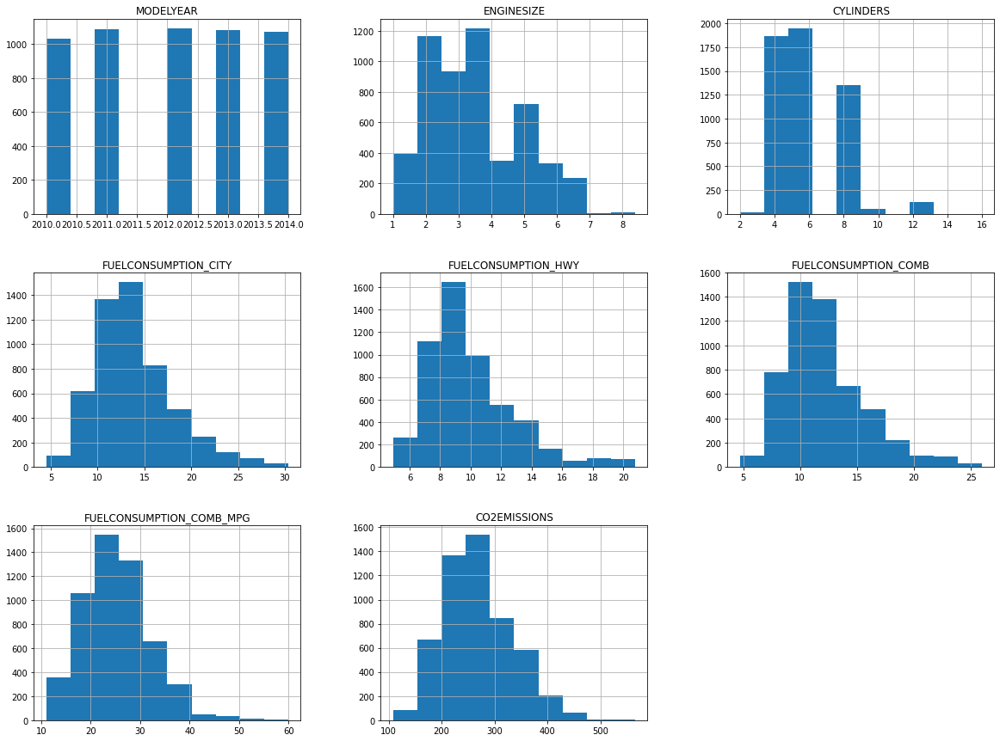

In [ ]:
df.hist(figsize = (20,15))
plt.show()

* The distribution for CYLINDERS appears to be descrete.
* The distribution for FUELCONSUMPTION_CITY, FUELCONSUMPTION_HWY and FUELCONSUMPTION_COMB appears to be right skewed. This can also be confirmed by looking at the mean and median.

In [ ]:
df.describe().transpose() # printing the basic statistics of the dataset

,count,mean,std,min,25%,50%,75%,max
MODELYEAR,5359.0,2012.014742,1.404536,2010.0,2011.0,2012.0,2013.0,2014.0
ENGINESIZE,5359.0,3.491901,1.390957,1.0,2.4,3.5,4.6,8.4
CYLINDERS,5359.0,5.962120,1.872838,2.0,4.0,6.0,8.0,16.0
FUELCONSUMPTION_CITY,5359.0,13.902650,4.162894,4.5,11.0,13.2,16.0,30.4
FUELCONSUMPTION_HWY,5359.0,9.932208,2.807196,4.9,8.0,9.3,11.2,20.8
FUELCONSUMPTION_COMB,5359.0,12.116328,3.524127,4.7,9.7,11.4,13.9,26.0
FUELCONSUMPTION_COMB_MPG,5359.0,25.168875,6.956407,11.0,20.0,25.0,29.0,60.0
CO2EMISSIONS,5359.0,267.660198,64.317040,108.0,221.0,260.0,305.0,566.0


### Tools for categorical data
Most machine learning algorithms accepts only numerical features. Hence, the need to convert text to numbers. There two methods used: Label Encoding and One Hot Encoding. Label encoding assigns labels to the categories while one hot encoding converts each category to a column with 1 assigned to indicate the position of the data and 0 assigned to the rest of the columns. We use Label encoding so not to increase the number of columns.

In [ ]:
df.reset_index(inplace=True) 
df.drop(df[['index']], axis = 1, inplace = True)

In [ ]:
my_object_df = df.select_dtypes(include = 'object') # obtains all the datatypes that are objects 
my_object_df.head(10) # print the first 10 rows

,MAKE,MODEL,VEHICLECLASS,TRANSMISSION,FUELTYPE
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z
5,ACURA,RL AWD,MID-SIZE,AS5,Z
6,ACURA,TL,MID-SIZE,AS5,Z
7,ACURA,TL AWD,MID-SIZE,AS5,Z
8,ACURA,TL AWD,MID-SIZE,M6,Z
9,ACURA,TSX,COMPACT,AS5,Z


In [ ]:
my_numeric_df = df.select_dtypes(exclude ='object') # obtains the numerical data type 
my_numeric_df.head(10)

,MODELYEAR,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
0,2010,2.0,4,10.9,7.8,9.5,30.0,219.0
1,2010,2.0,4,10.0,7.6,8.9,32.0,205.0
2,2010,2.0,4,11.6,8.1,10.0,28.0,230.0
3,2010,3.7,6,14.8,11.3,13.2,21.0,304.0
4,2010,2.3,4,13.2,10.3,11.9,24.0,274.0
5,2010,3.7,6,14.7,10.6,12.9,22.0,297.0
6,2010,3.5,6,13.1,8.9,11.2,25.0,258.0
7,2010,3.7,6,13.8,9.6,11.9,24.0,274.0
8,2010,3.7,6,13.4,9.5,11.6,24.0,267.0
9,2010,2.4,4,11.0,7.8,9.5,30.0,219.0


Label encoding

In [ ]:
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

In [ ]:
my_object_df['FUELTYPE'].unique()

array(['X', 'Z', 'D', 'E'], dtype=object)

In [ ]:
le = LabelEncoder()# declares an instance of the object
le_data = le.fit_transform(my_object_df[['FUELTYPE']])# applies the object to data 
df_le = pd.DataFrame(le_data, columns = ['FUELTYPE']) # creates a dataframe 
new_df_le = pd.concat([my_numeric_df,df_le], axis = 1) # join to the numeric columns for further analysis
new_df_le

/usr/local/lib/python3.8/dist-packages/sklearn/preprocessing/_label.py:115: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,MODELYEAR,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS,FUELTYPE
0,2010,2.0,4,10.9,7.8,9.5,30.0,219.0,2
1,2010,2.0,4,10.0,7.6,8.9,32.0,205.0,2
2,2010,2.0,4,11.6,8.1,10.0,28.0,230.0,3
3,2010,3.7,6,14.8,11.3,13.2,21.0,304.0,3
4,2010,2.3,4,13.2,10.3,11.9,24.0,274.0,3
...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6,13.4,9.8,11.8,24.0,271.0,2
5355,2014,3.2,6,13.2,9.5,11.5,25.0,264.0,2
5356,2014,3.0,6,13.4,9.8,11.8,24.0,271.0,2
5357,2014,3.2,6,12.9,9.3,11.3,25.0,260.0,2


### Exploratory Data Analysis

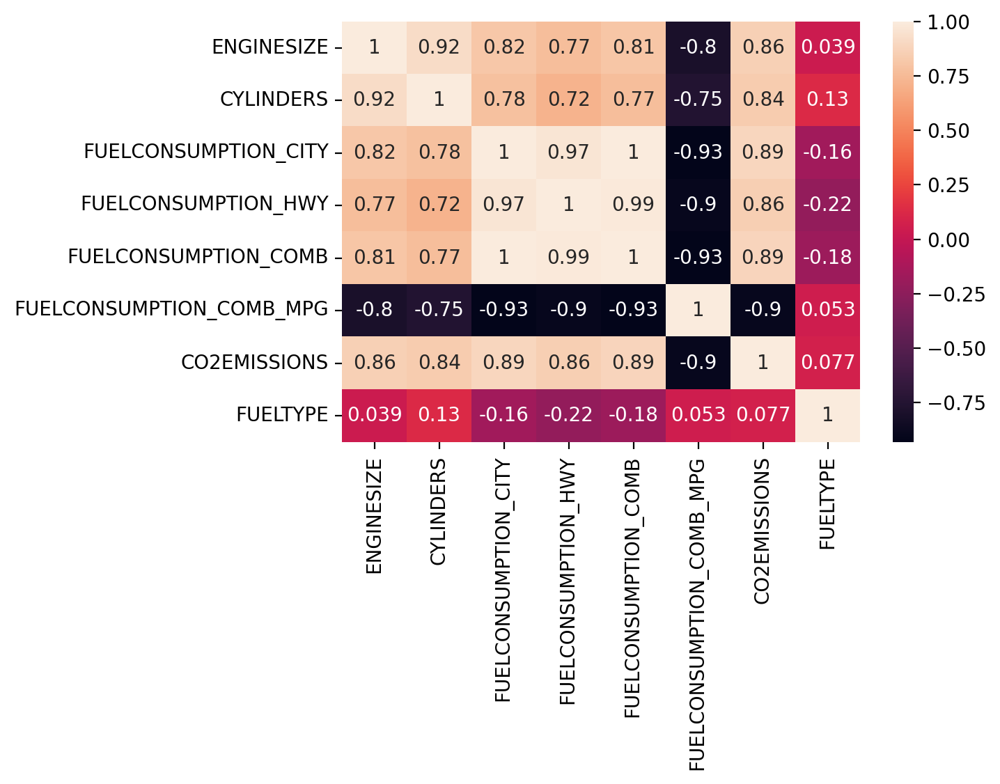

In [ ]:
plt.figure(dpi=200)
new_df_le.drop(df[['MODELYEAR']], axis = 1, inplace=True)
sns.heatmap(new_df_le.corr(), annot = True) # checking for correlation to see if any of the variables have strong relationship
#plt.savefig('heatmap.png')

Here we see good correlation between the variables except from FUELTYPE.

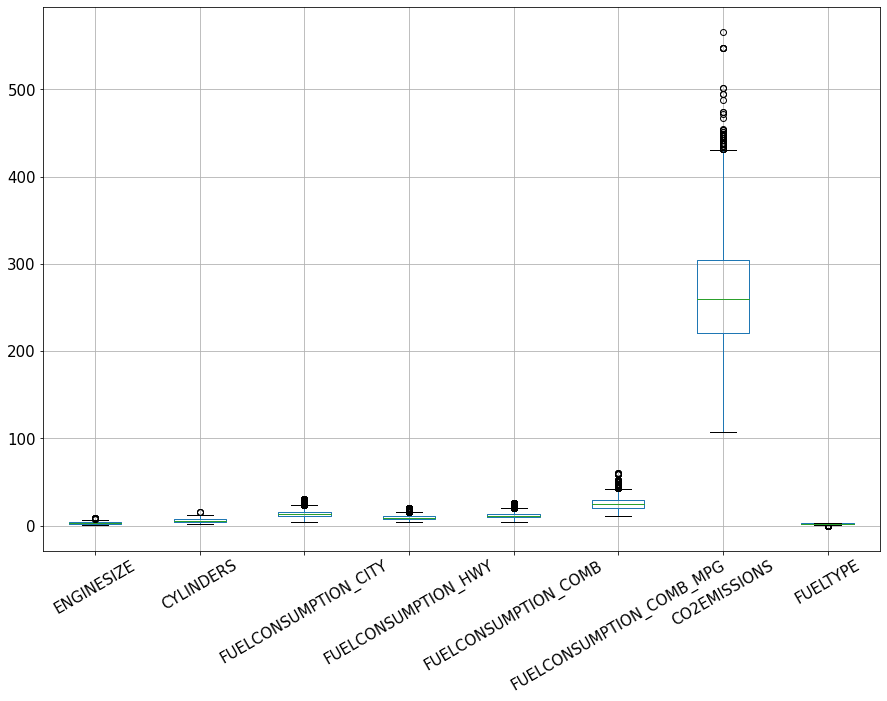

In [ ]:
new_df_le.boxplot(figsize = (15,10), fontsize = 15, rot = 30) 
plt.show()

##### The boxplot shows that some of the variables exert dominance over the others hence the need for scaling.

## Building the machine learning model 
### Linear regression

In [ ]:
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import MinMaxScaler

Creating the train, validation and test dataset
Let's split our dataset into train and test sets. 80% of the entire dataset will be used for training and 20% for testing. Futhermore, we split the 80% of train data to validation data(20%) for validation.

In [ ]:
X = new_df_le.drop('CO2EMISSIONS',axis=1) # features
y = new_df_le['CO2EMISSIONS'] # target variable
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X,y = X_train,y_train
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

Scaling the dataset

In [ ]:
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train) 
X_test_scaled = scaler.transform(X_test) 
X_val_scaled = scaler.transform(X_val)

In [ ]:
#converting to pandas dataframe
X_train_scaled = pd.DataFrame(X_train_scaled, columns = X_train.columns) 
X_test_scaled = pd.DataFrame(X_test_scaled, columns = X_test.columns) 
X_val_scaled = pd.DataFrame(X_val_scaled, columns = X_val.columns)

In [ ]:
X_val_scaled

,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,FUELTYPE
0,0.500000,0.428571,0.528958,0.427673,0.497653,0.142857,1.000000
1,0.202703,0.142857,0.285714,0.226415,0.267606,0.326531,0.666667
2,0.351351,0.285714,0.378378,0.314465,0.356808,0.244898,0.666667
3,0.540541,0.428571,0.432432,0.383648,0.417840,0.204082,1.000000
4,0.270270,0.285714,0.525097,0.566038,0.539906,0.122449,0.333333
...,...,...,...,...,...,...,...
853,0.500000,0.428571,0.471042,0.446541,0.464789,0.163265,0.666667
854,0.256757,0.142857,0.347490,0.327044,0.342723,0.265306,0.666667
855,0.337838,0.285714,0.393822,0.364780,0.384977,0.224490,0.666667
856,0.540541,0.428571,0.409266,0.358491,0.394366,0.224490,1.000000


#### Linear Regression Model

In [ ]:
from sklearn.linear_model import LinearRegression # importing the model 
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score # performance metrics

In [ ]:
model = LinearRegression() #instantiating the model

In [ ]:
# The model test report
def report_model_test(model, x_train, x_test, y_train, y_test):
    model.fit(x_train,y_train)
    basem_preds = model.predict(x_test)
    mean_abs = mean_absolute_error(y_test,basem_preds)
    mean_squared = mean_squared_error(y_test,basem_preds)
    r2_coeff = r2_score(y_test,basem_preds)
    print(f"The result of the mean absolute error is: {mean_abs:.2f}")
    print(f"The result of the root mean squared error is : {np.sqrt(mean_squared):.2f}") 
    print(f"The result of the coefficient of determination is: {r2_coeff:.2f}")


1. Train the model with a single feature e.g enginesize

In [ ]:
# Reshaping the attribute
X_train_scaled_EngSize = X_train_scaled['ENGINESIZE'].to_numpy().reshape(-1,1) 
X_val_scaled_EngSize = X_val_scaled['ENGINESIZE'].to_numpy().reshape(-1,1) 
X_test_scaled_EngSize = X_test_scaled['ENGINESIZE'].to_numpy().reshape(-1,1)

In [ ]:
report_model_test(model,
                  X_train_scaled_EngSize,
                  X_test_scaled_EngSize,
                  y_train,
                  y_test)

The result of the mean absolute error is: 24.48
The result of the root mean squared error is : 33.08
The result of the coefficient of determination is: 0.73


training the model with just feature results in a low model performance (73% accuracy). We train with all the data features

#### Multiple linear regression

In [ ]:
##Using all features
report_model_test(model,
                  X_train_scaled,
                  X_test_scaled,
                  y_train,
                  y_test)

The result of the mean absolute error is: 15.03
The result of the root mean squared error is : 21.51
The result of the coefficient of determination is: 0.89


In [ ]:
# Training the model with only fuel consumption(mpg) and cylinders
report_model_test(model,
                  X_train_scaled[['FUELCONSUMPTION_COMB_MPG','CYLINDERS']],
                  X_test_scaled[['FUELCONSUMPTION_COMB_MPG','CYLINDERS']],
                  y_train,
                  y_test)

The result of the mean absolute error is: 15.45
The result of the root mean squared error is : 23.44
The result of the coefficient of determination is: 0.87


In [ ]:
##Using all features except fueltype since it has poor correlation with CO2 emissions from the heatmap
report_model_test(model,
                  X_train_scaled.drop('FUELTYPE', axis=1),
                  X_test_scaled.drop('FUELTYPE', axis=1),
                  y_train,
                  y_test)

The result of the mean absolute error is: 15.05
The result of the root mean squared error is : 22.74
The result of the coefficient of determination is: 0.87


Another approach:
1. arrange the correlation with co2 emissions in descending other
2. starting from the highest correlation and adding features, run model, check accuracy or error
3. if feature increases error or decreases accuracy, drop features, hence keep feature

From the feature combinations, multiple linear regression performed better than simple linear regression.

using all the numerical feautres and the fuel type outperforms the other feature selections

### Classification

Using the categorical variable as the target variable in classifying the dataset.

Using each categorical variable as the target variable at each instance, determine which of the variables performed best in classifying the dataset. Explain your findings.



In [ ]:
my_object_df

,MAKE,MODEL,VEHICLECLASS,TRANSMISSION,FUELTYPE
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z
...,...,...,...,...,...
5354,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5355,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5356,VOLVO,XC70 AWD,SUV - SMALL,AS6,X
5357,VOLVO,XC70 AWD,SUV - SMALL,AS6,X


In [ ]:
my_object_df['FUELTYPE'].unique()

array(['X', 'Z', 'D', 'E'], dtype=object)

In [ ]:
my_object_df['FUELTYPE'].value_counts()

X    2663
Z    2125
E     481
D      90
Name: FUELTYPE, dtype: int64

* Balance the dataset

Looking at the value counts for fuel type, the data is not balance as some categories are more values than others. hence the need to balance the dataset.
I use Synthetic Minority Over-sampling Technique (SMOTE) to balance the data

In [ ]:
my_object_df.head()

,MAKE,MODEL,VEHICLECLASS,TRANSMISSION,FUELTYPE
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z


In [ ]:
my_numeric_df.head()

,MODELYEAR,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
0,2010,2.0,4,10.9,7.8,9.5,30.0,219.0
1,2010,2.0,4,10.0,7.6,8.9,32.0,205.0
2,2010,2.0,4,11.6,8.1,10.0,28.0,230.0
3,2010,3.7,6,14.8,11.3,13.2,21.0,304.0
4,2010,2.3,4,13.2,10.3,11.9,24.0,274.0


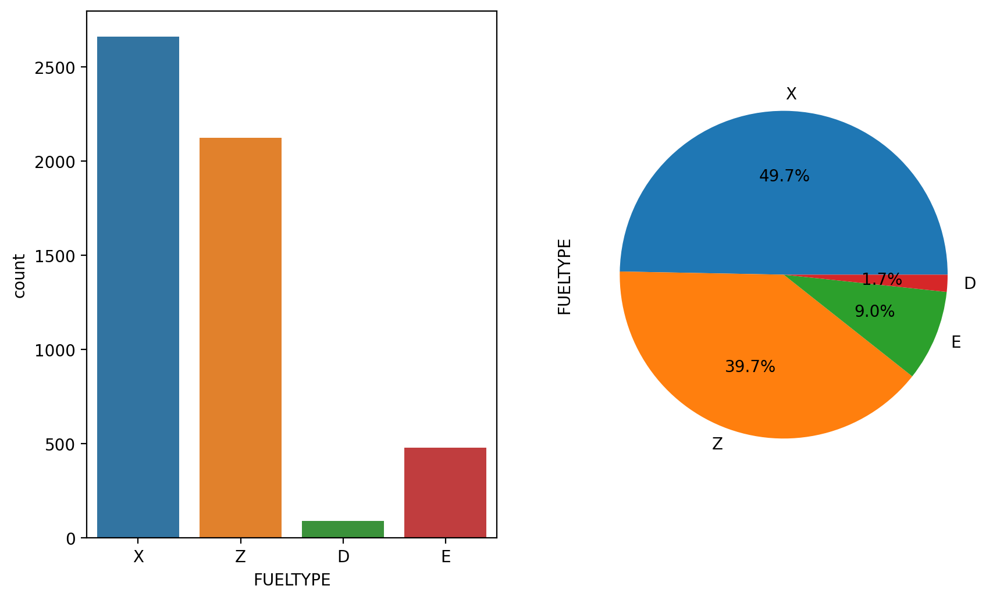

In [ ]:
fig, ax_position=plt.subplots(1,2,figsize=(15,6),dpi=200) # creates the framework for the plotting
a = sns.countplot(x='FUELTYPE', data=my_object_df, ax=ax_position[0]) #ax_position[0] specifies plot to be in index 0
a= my_object_df['FUELTYPE'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax_position[1]) #ax_position[1] specifies plot to be in index 1


In [ ]:
# setting the features and targets
X = my_numeric_df.drop('MODELYEAR',axis=1) 
y = my_object_df['FUELTYPE']

#### Applying SMOTE

In [ ]:
#!pip install imblearn

In [ ]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42) # The object is created 
X_res, y_res = sm.fit_resample(X, y) # The object is applied
X, y = X_res, y_res # reassigning the balanced dataset to X,y

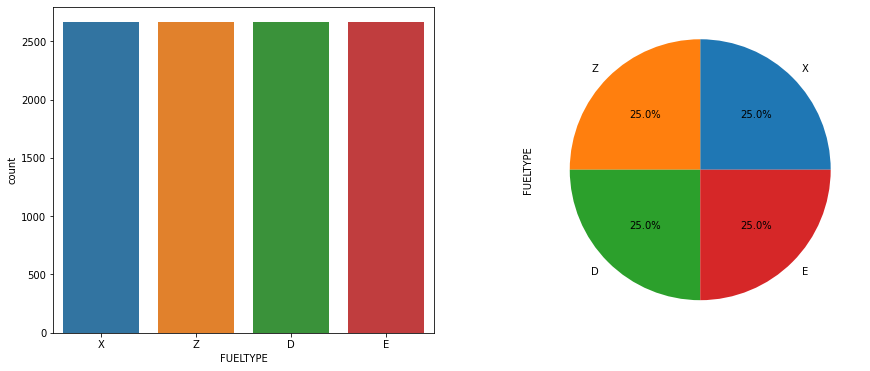

In [ ]:
# Plot of the dataset
df_bal = pd.concat([X_res,y_res], axis = 1) # creating a dataframe for the balanced data
fig, ax=plt.subplots(1,2,figsize=(15,6)) # creating the axis shell for subplot
a = sns.countplot(x='FUELTYPE',data=df_bal, ax=ax[0]) # assigning each of the plot to the axis shell
a= df_bal['FUELTYPE'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1]) # assigning each of the plot to the axis shell

Spliting the dataset

In [ ]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=42) # split data into train and test
X,y = X_train,y_train
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42) #split train into training and validation data

Scaling the dataset

In [ ]:
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train) #scale train data
X_test_scaled = scaler.transform(X_test) # scale test data
X_val_scaled = scaler.transform(X_val) # scale validation data


Importing the evaluation metrics

In [ ]:
#from sklearn.model_selection import train_test_split
from sklearn.metrics import (accuracy_score, classification_report, 
                             confusion_matrix, ConfusionMatrixDisplay,
                             plot_roc_curve,roc_auc_score)

### Build Classification model



Logistic regression

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
model = LogisticRegression()

In [ ]:
def report_model_test(model,X_train_scaled,X_test_scaled,y_train,y_test, name):
  print(f"{name} Model Analysis:\n")
  model.fit(X_train_scaled,y_train) # train model
  basem_preds = model.predict(X_test_scaled) # evaluate model
  print(classification_report(y_test,basem_preds)) # get performace metrics report
  ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test) #plot confusion matrix
  plt.show()
  plt.figure(figsize=(40,40), dpi = 200)

  if name == 'DTree':
    feature_importance = pd.DataFrame(data=model.feature_importances_, index = X.columns, 
                                      columns = ['Feature_importance']).sort_values('Feature_importance') # get feature importance in decending other i.e most impactful features on top
    print(feature_importance)
    plot_tree(model, feature_names = X.columns, filled = True, fontsize=20 )
    #plt.figure(figsize=(40,40), dpi = 200)
  else:
    pass


LR Model Analysis:



/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

           D       0.95      1.00      0.97       534
           E       1.00      0.99      0.99       526
           X       0.62      0.60      0.61       520
           Z       0.65      0.64      0.65       551

    accuracy                           0.81      2131
   macro avg       0.80      0.81      0.81      2131
weighted avg       0.80      0.81      0.80      2131



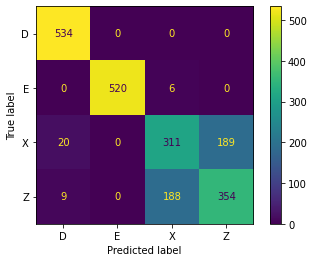

<Figure size 8000x8000 with 0 Axes>

In [ ]:
report_model_test(model,X_train_scaled,X_test_scaled,y_train,y_test, 'LR')

Decision tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier 
from sklearn.tree import plot_tree

DTree Model Analysis:

              precision    recall  f1-score   support

           D       1.00      1.00      1.00       534
           E       1.00      1.00      1.00       526
           X       0.91      0.93      0.92       520
           Z       0.93      0.91      0.92       551

    accuracy                           0.96      2131
   macro avg       0.96      0.96      0.96      2131
weighted avg       0.96      0.96      0.96      2131



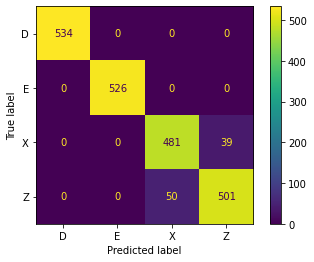

                          Feature_importance
CYLINDERS                           0.025707
FUELCONSUMPTION_COMB                0.047321
FUELCONSUMPTION_COMB_MPG            0.115730
ENGINESIZE                          0.127907
CO2EMISSIONS                        0.172909
FUELCONSUMPTION_HWY                 0.248115
FUELCONSUMPTION_CITY                0.262312


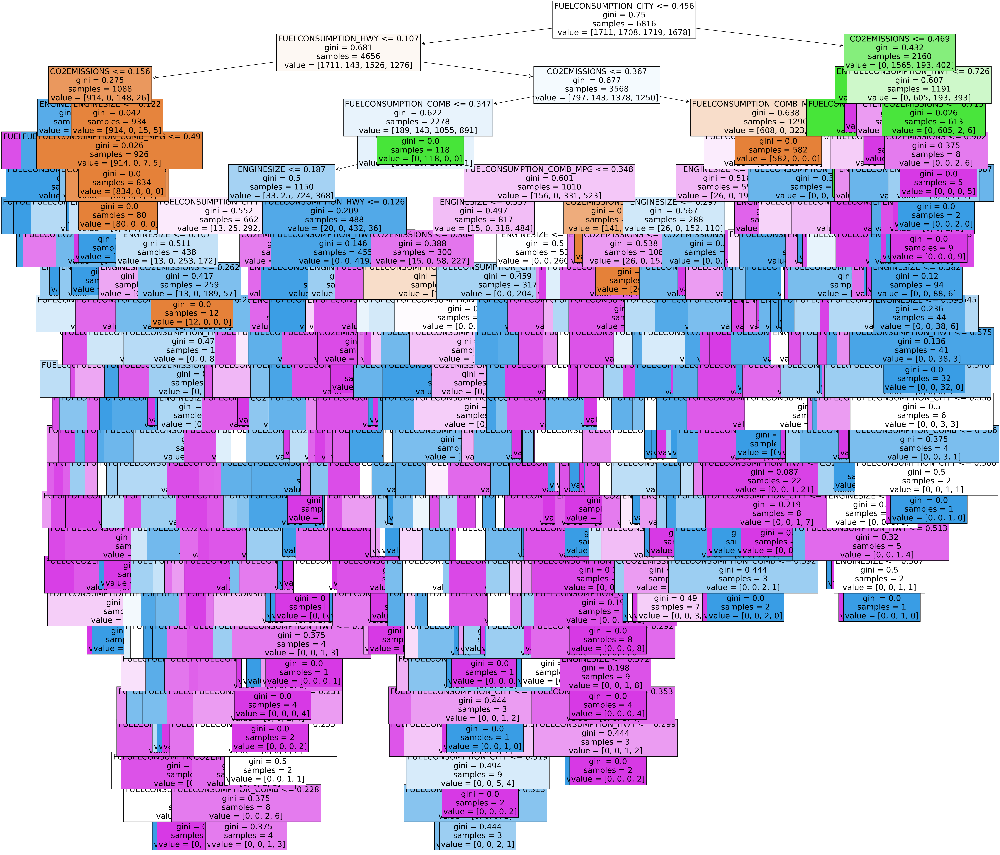

In [ ]:
model_Tree = DecisionTreeClassifier()
report_model_test(model_Tree,X_train_scaled,X_test_scaled,y_train,y_test, 'DTree')

KNeighborsClassifier

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

KNN Model Analysis:

              precision    recall  f1-score   support

           D       1.00      1.00      1.00       534
           E       1.00      1.00      1.00       526
           X       0.87      0.86      0.86       520
           Z       0.87      0.87      0.87       551

    accuracy                           0.93      2131
   macro avg       0.93      0.93      0.93      2131
weighted avg       0.93      0.93      0.93      2131



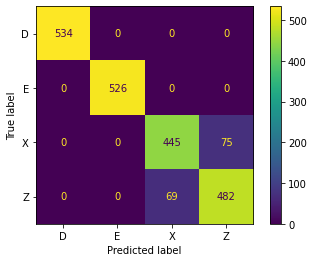

<Figure size 8000x8000 with 0 Axes>

In [ ]:
model_KNN = KNeighborsClassifier() # instance of the model object
report_model_test(model_KNN,X_train_scaled,X_test_scaled,y_train,y_test, 'KNN')

Support vector machines (svm)

SVC Model Analysis:

              precision    recall  f1-score   support

           D       1.00      1.00      1.00       534
           E       1.00      1.00      1.00       526
           X       0.65      0.67      0.66       520
           Z       0.68      0.66      0.67       551

    accuracy                           0.83      2131
   macro avg       0.83      0.83      0.83      2131
weighted avg       0.83      0.83      0.83      2131



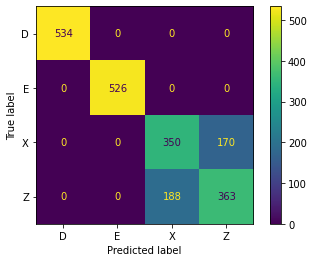

<Figure size 8000x8000 with 0 Axes>

In [ ]:
from sklearn.svm import SVC # SVC: support vector classifier
model_SVC = SVC()
report_model_test(model_SVC,X_train_scaled,X_test_scaled,y_train,y_test, 'SVC')

Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

RF Model Analysis:

              precision    recall  f1-score   support

           D       1.00      1.00      1.00       534
           E       1.00      1.00      1.00       526
           X       0.90      0.92      0.91       520
           Z       0.92      0.91      0.91       551

    accuracy                           0.96      2131
   macro avg       0.96      0.96      0.96      2131
weighted avg       0.96      0.96      0.96      2131



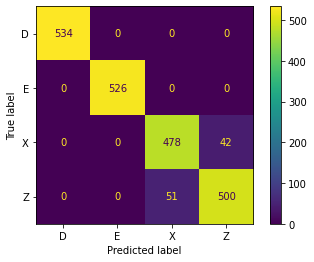

<Figure size 8000x8000 with 0 Axes>

In [ ]:
model_RF = RandomForestClassifier()
report_model_test(model_RF,X_train_scaled,X_test_scaled,y_train,y_test, 'RF')

From the tested algorithms Decision tree performs well. There using Decision Tree as the model for classifying the dataset using each categorical column as tagert.

In [ ]:
def categorical_variable_classification(my_numeric_df,my_object_df, cat_variable): 
  X = my_numeric_df.drop('MODELYEAR',axis=1) 
  y = my_object_df[cat_variable]

  #Balance the dataset
  from imblearn.over_sampling import SMOTE
  sm = SMOTE(random_state=42)
  X_res, y_res = sm.fit_resample(X, y)
  X, y = X_res, y_res # reassigning the balanced dataset to X,y

  #Spliting the dataset
  X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=42) # split data into train and test
  X,y = X_train,y_train
  X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42) #split train into training and validation data

  #Scaling the dataset
  scaler = MinMaxScaler()
  X_train_scaled = scaler.fit_transform(X_train) #scale train data
  X_test_scaled = scaler.transform(X_test) # scale test data
  X_val_scaled = scaler.transform(X_val) # scale validation data

  #build model
  model = DecisionTreeClassifier()
  model.fit(X_train_scaled,y_train) # train model
  basem_preds = model.predict(X_test_scaled) # evaluate model
  print(f"{cat_variable} Model Analysis:\n")
  print(classification_report(y_test,basem_preds)) # get performace metrics report
  ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test) #plot confusion matrix
  plt.show()
  plt.figure(figsize=(40,40), dpi = 200)

In [ ]:
my_object_df.columns

Index(['MAKE', 'MODEL', 'VEHICLECLASS', 'TRANSMISSION', 'FUELTYPE'], dtype='object')

VEHICLECLASS Model Analysis:

                          precision    recall  f1-score   support

                 COMPACT       0.51      0.53      0.52       152
               FULL-SIZE       0.74      0.77      0.75       149
                MID-SIZE       0.62      0.62      0.62       142
             MINICOMPACT       0.77      0.87      0.82       173
                 MINIVAN       0.92      0.94      0.93       150
    PICKUP TRUCK - SMALL       0.97      1.00      0.99       133
 PICKUP TRUCK - STANDARD       0.82      0.79      0.81       173
 SPECIAL PURPOSE VEHICLE       0.97      0.94      0.95       146
STATION WAGON - MID-SIZE       0.89      0.91      0.90       163
   STATION WAGON - SMALL       0.76      0.79      0.77       149
              SUBCOMPACT       0.63      0.57      0.60       155
                     SUV       0.59      0.63      0.61       162
             SUV - SMALL       0.73      0.70      0.71       153
          SUV - STANDARD       0.71      0.68

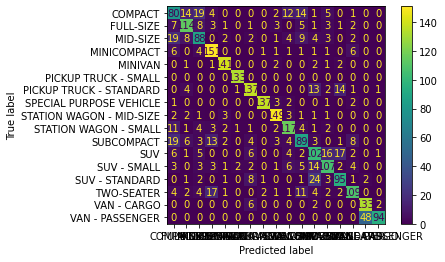

<Figure size 8000x8000 with 0 Axes>

In [ ]:
categorical_variable_classification(my_numeric_df,my_object_df, 'VEHICLECLASS')

FUELTYPE Model Analysis:

              precision    recall  f1-score   support

           D       1.00      1.00      1.00       534
           E       1.00      1.00      1.00       526
           X       0.90      0.93      0.91       520
           Z       0.93      0.91      0.92       551

    accuracy                           0.96      2131
   macro avg       0.96      0.96      0.96      2131
weighted avg       0.96      0.96      0.96      2131



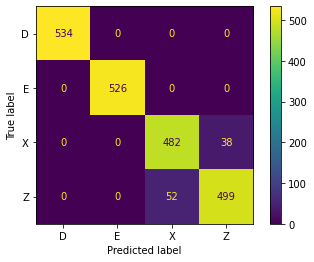

<Figure size 8000x8000 with 0 Axes>

In [ ]:
categorical_variable_classification(my_numeric_df,my_object_df, 'FUELTYPE')

In [ ]:
#categorical_variable_classification(my_numeric_df,my_object_df, 'MODEL')

In [ ]:
my_object_df['MODEL'].value_counts()

SIERRA 4WD       33
SIERRA           33
SILVERADO        33
SILVERADO 4WD    33
F150 FFV 4X4     26
                 ..
VIPER             1
VIPER GTS         1
M35X              1
M35               1
XK 5.0 COUPE      1
Name: MODEL, Length: 1210, dtype: int64

### Cross validation
This is done to check that the model does not overfit

In [ ]:
from sklearn.model_selection import cross_validate, KFold, cross_val_score
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score

In [ ]:
kfold = KFold(n_splits=5) # cv of 5
model = DecisionTreeClassifier()
cv_result = cross_val_score(model,X_train_scaled,y_train, cv = kfold,scoring = "accuracy") 
print('Mean:', cv_result.mean(),'\n')

Mean: 0.9487986866989541 



In [ ]:
cv_result

array([0.93695015, 0.94644167, 0.96184886, 0.94717535, 0.9515774 ])

Hyperparameter tuning using GridSearchCV

In [ ]:
from sklearn.model_selection import GridSearchCV # importing GridSearchCV

In [ ]:
model = DecisionTreeClassifier() # instiatiate the model

In [ ]:
grid_param={'max_features': ['auto', 'sqrt', 'log2'],
            'ccp_alpha': [0.1, 0.01, 0.001],
            'max_depth' : list(range(10, 15)),
            'criterion' :['gini', 'entropy']} # declaring the parameter to tune with

In [ ]:
gd_DTree = GridSearchCV(estimator=model, 
                     param_grid=grid_param,
                     scoring='accuracy',
                     cv=5,
                     n_jobs=-1) # instantiating an object of GridSearchCV

In [ ]:
gd_DTree.fit(X_train_scaled, y_train) # fitting the object

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'ccp_alpha': [0.1, 0.01, 0.001],
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [10, 11, 12, 13, 14],
                         'max_features': ['auto', 'sqrt', 'log2']},
             scoring='accuracy')

In [ ]:
gd_DTree.best_estimator_

DecisionTreeClassifier(ccp_alpha=0.001, criterion='entropy', max_depth=14,
                       max_features='log2')

In [ ]:
# Training and evaluating the grid model
def report_model_test(model):
  model.fit(X_train_scaled,y_train)
  basem_preds = model.predict(X_test_scaled) 
  print(classification_report(y_test,basem_preds)) 
  ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test) 
  plt.show()
  plt.figure(figsize=(40,40), dpi = 200);


              precision    recall  f1-score   support

           D       1.00      0.99      0.99       534
           E       1.00      1.00      1.00       526
           X       0.80      0.82      0.81       520
           Z       0.82      0.80      0.81       551

    accuracy                           0.90      2131
   macro avg       0.90      0.90      0.90      2131
weighted avg       0.90      0.90      0.90      2131



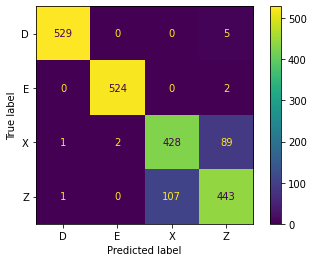

<Figure size 8000x8000 with 0 Axes>

In [ ]:
report_model_test(gd_DTree) # using the gridsearch model to predict

In [ ]:
grid_param

{'max_features': ['auto', 'sqrt', 'log2'],
 'ccp_alpha': [0.1, 0.01, 0.001],
 'max_depth': [10, 11, 12, 13, 14],
 'criterion': ['gini', 'entropy']}

#Clustering analysis
Use only the non-categorical variables to form groups

In [ ]:
my_numeric_df.head()

,MODELYEAR,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
0,2010,2.0,4,10.9,7.8,9.5,30.0,219.0
1,2010,2.0,4,10.0,7.6,8.9,32.0,205.0
2,2010,2.0,4,11.6,8.1,10.0,28.0,230.0
3,2010,3.7,6,14.8,11.3,13.2,21.0,304.0
4,2010,2.3,4,13.2,10.3,11.9,24.0,274.0


In [ ]:
my_numeric_df.drop('MODELYEAR', axis = 1, inplace = True) # dropping model year since is not useful

/usr/local/lib/python3.8/dist-packages/pandas/core/frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


1. Standardised the data. clustering algorithms used are distance based, therefore it is essential to scale our data.

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
scaler = StandardScaler() # instantiate StandardScaler() object

In [ ]:
scaled_num_df = scaler.fit_transform(my_numeric_df)

In [ ]:
scaled_num_df

array([[-1.0726722 , -1.04776951, -0.72135632, ..., -0.74247367,
         0.69455053, -0.75663834],
       [-1.0726722 , -1.04776951, -0.93757224, ..., -0.91274447,
         0.98208211, -0.97433036],
       [-1.0726722 , -1.04776951, -0.55318838, ..., -0.60058134,
         0.40701895, -0.58559461],
       ...,
       [-0.35367552,  0.02022798, -0.12075653, ..., -0.08976894,
        -0.16804421,  0.05193202],
       [-0.20987619,  0.02022798, -0.24087649, ..., -0.23166128,
        -0.02427842, -0.11911171],
       [-0.20987619,  0.02022798,  0.23960334, ...,  0.19401572,
        -0.45557579,  0.40956891]])

2. Apply KMeans clustering to build the cluster


In [ ]:
from sklearn.cluster import KMeans

In [ ]:
model = KMeans(n_clusters=7) # number of clusters is 7

In [ ]:
cluster_labels = model.fit_predict(scaled_num_df) # fiting and predicting the clusters

In [ ]:
cluster_labels

array([5, 5, 5, ..., 2, 2, 0], dtype=int32)

In [ ]:
my_numeric_df['CLUSTER'] = cluster_labels

<ipython-input-85-4c53aaf10cce>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  my_numeric_df['CLUSTER'] = cluster_labels


In [ ]:
my_numeric_df

,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS,CLUSTER
0,2.0,4,10.9,7.8,9.5,30.0,219.0,5
1,2.0,4,10.0,7.6,8.9,32.0,205.0,5
2,2.0,4,11.6,8.1,10.0,28.0,230.0,5
3,3.7,6,14.8,11.3,13.2,21.0,304.0,0
4,2.3,4,13.2,10.3,11.9,24.0,274.0,2
...,...,...,...,...,...,...,...,...
5354,3.0,6,13.4,9.8,11.8,24.0,271.0,2
5355,3.2,6,13.2,9.5,11.5,25.0,264.0,2
5356,3.0,6,13.4,9.8,11.8,24.0,271.0,2
5357,3.2,6,12.9,9.3,11.3,25.0,260.0,2


Clustering evaluation

Applying both the davies bouldin score and the silhouette score

In [ ]:
from sklearn.metrics import davies_bouldin_score, silhouette_score

In [ ]:
DB_index = davies_bouldin_score(scaled_num_df,cluster_labels)
sil_score = silhouette_score(scaled_num_df,cluster_labels) 

In [ ]:
print(f"The Davies bouldin score is {DB_index:.4f}\nThe Silhouette score is {sil_score:.4f}")

The Davies bouldin score is 0.8797
The Silhouette score is 0.4154


In [ ]:
my_numeric_df.drop('CLUSTER', axis = 1, inplace = True) 

/usr/local/lib/python3.8/dist-packages/pandas/core/frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


Suitable number of clusters
- Applying a range of k values and recoding their silhouette score

In [ ]:
# determining number of clusters
# using silhouette score method
sil_score = {}
#db_index = {}
for k in range(2, 20):
  model = KMeans(n_clusters=k)
  cluster_labels = model.fit_predict(scaled_num_df)
  #print(cluster_labels)
  sil_score[k] = silhouette_score(scaled_num_df,cluster_labels) 
#  db_index[k] = davies_bouldin_score(scaled_num_df,cluster_labels)



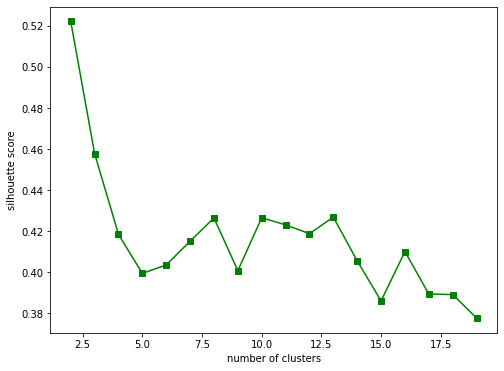

In [ ]:
# plotting the silhouette scores to find out the elbow value
plt.figure(figsize=(8,6))
plt.plot(list(sil_score.keys()), list(sil_score.values()), 'gs-')
plt.xlabel('number of clusters')
plt.ylabel('silhouette score')
plt.show()

Applying the elbow method a cluster of n=5 is be the best for clustering the numerical data

In [ ]:
model = KMeans(n_clusters=5) # number of clusters is 5
cluster_labels = model.fit_predict(scaled_num_df) # fiting and predicting the clusters
DB_index = davies_bouldin_score(scaled_num_df,cluster_labels)
sil_score = silhouette_score(scaled_num_df,cluster_labels) 
print(f"The Davies bouldin score is {DB_index:.4f}\nThe Silhouette score is {sil_score:.4f}")

The Davies bouldin score is 0.8707
The Silhouette score is 0.3982


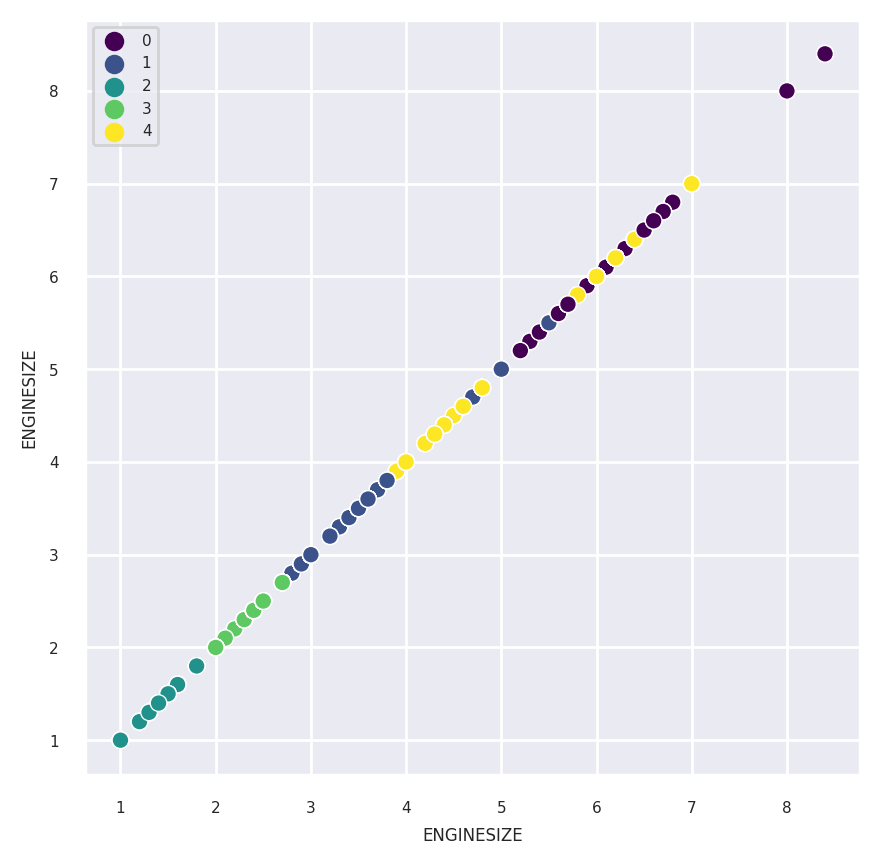

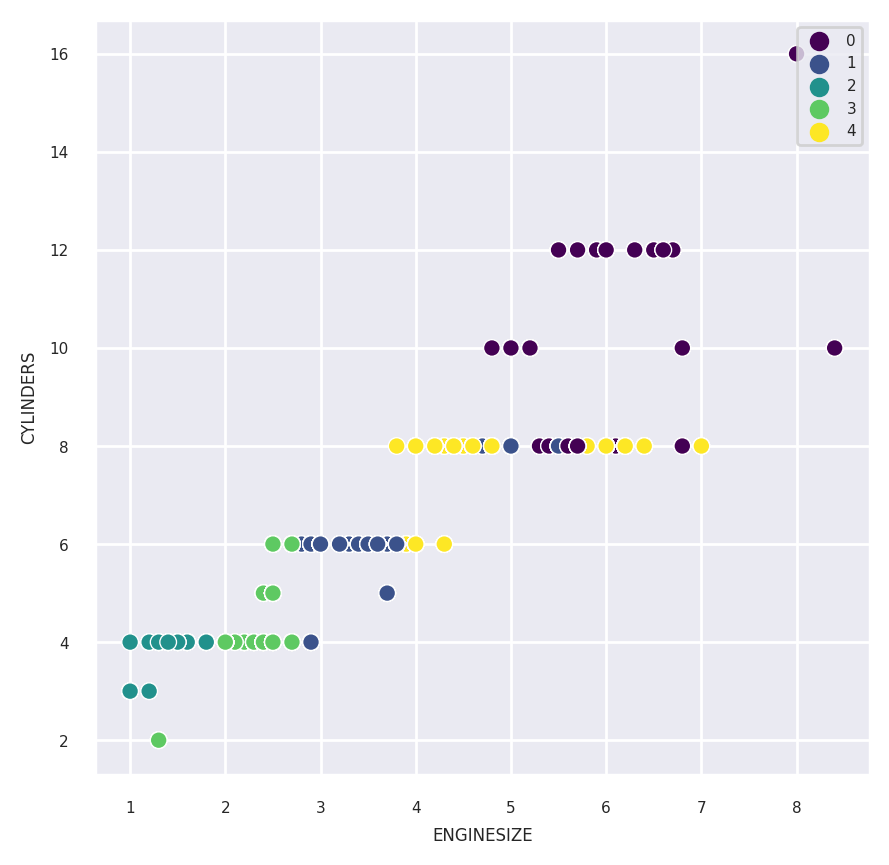

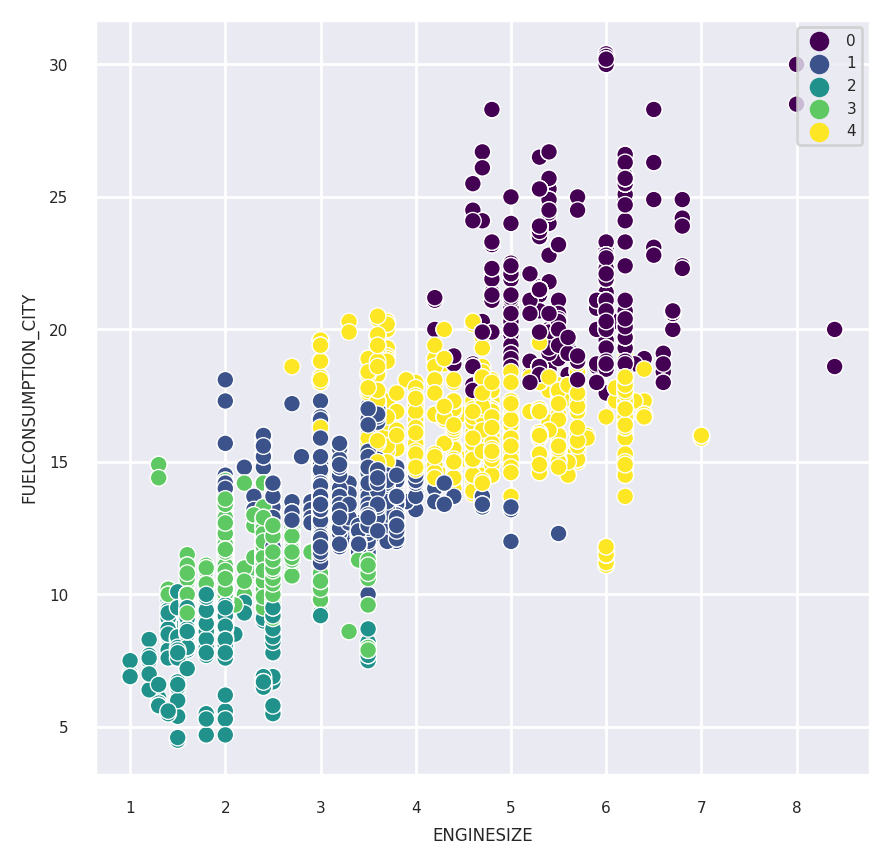

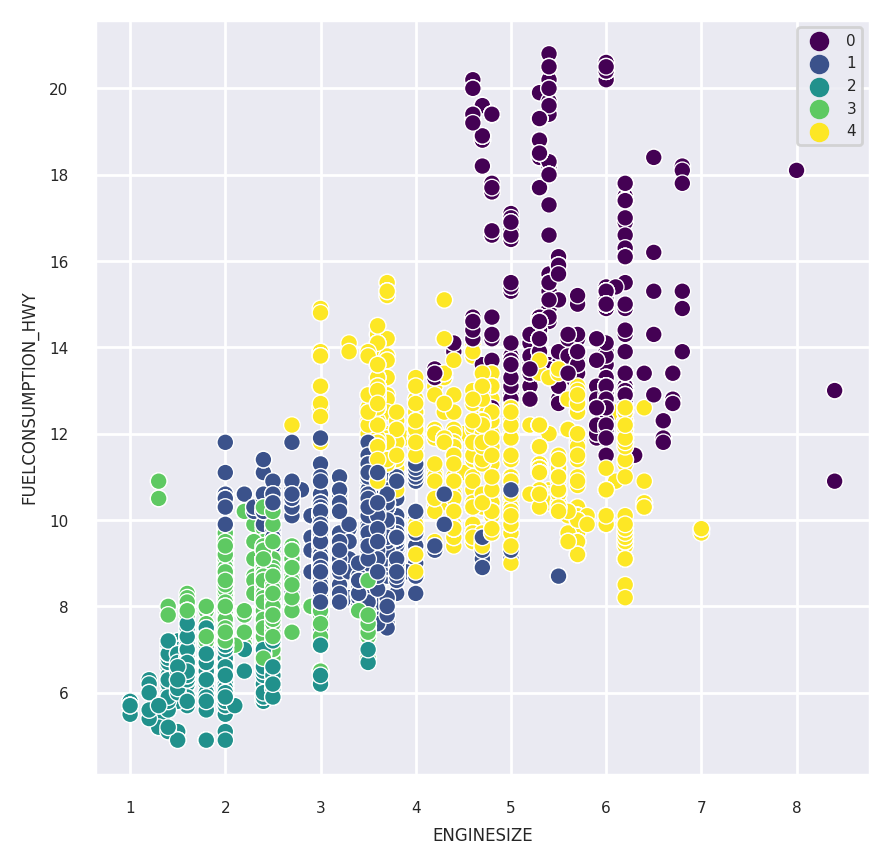

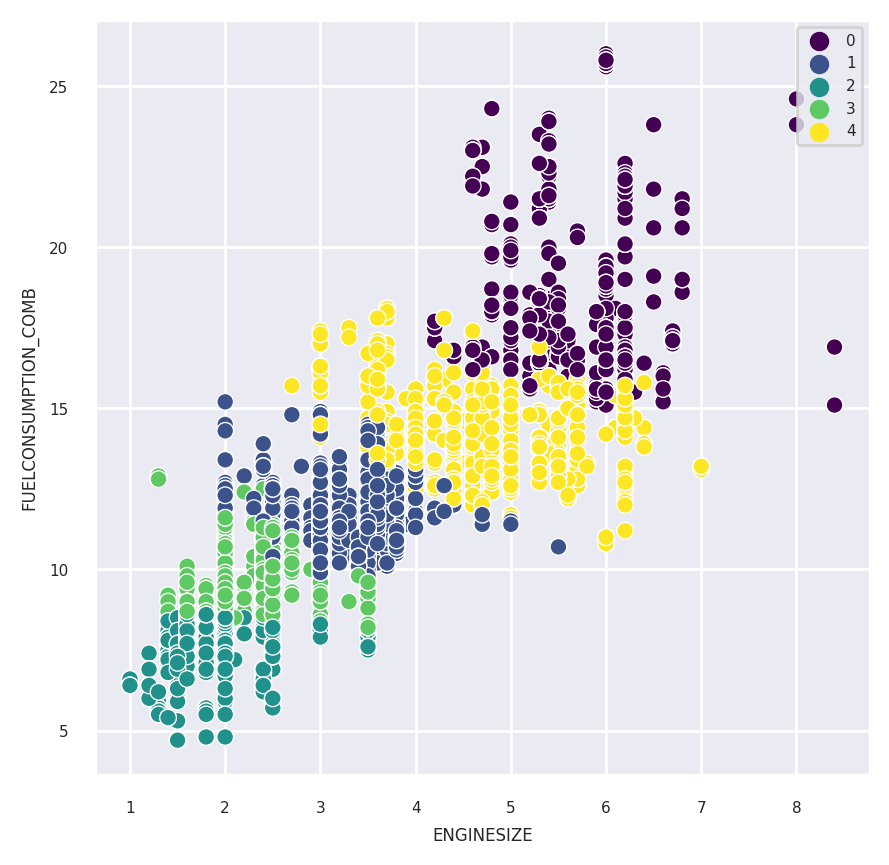

...

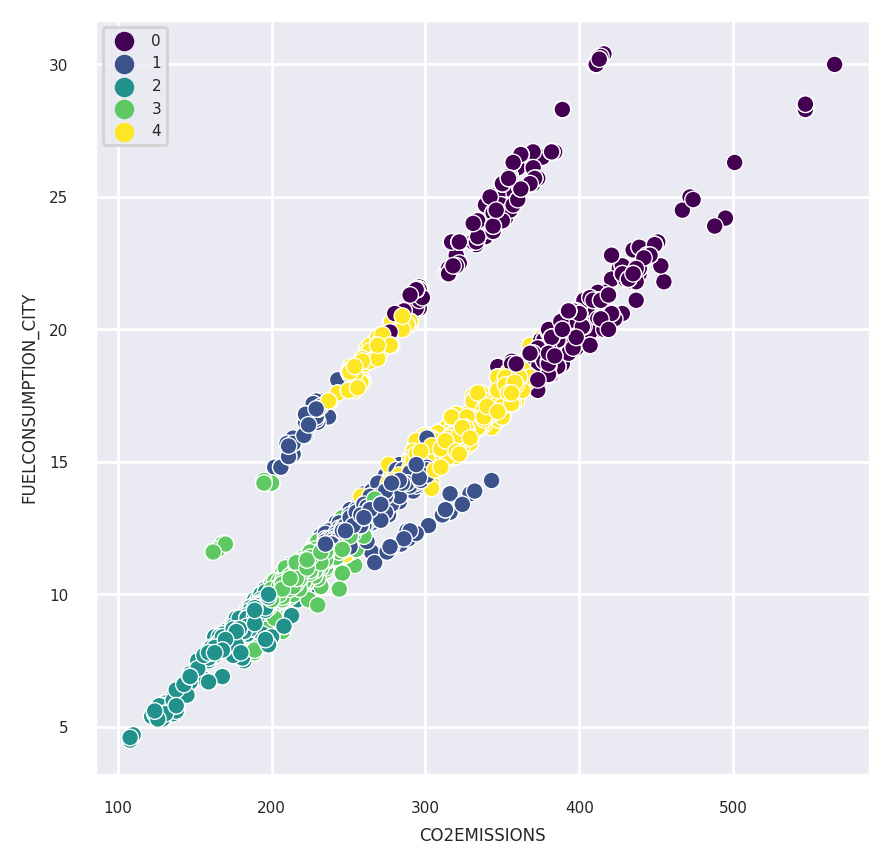

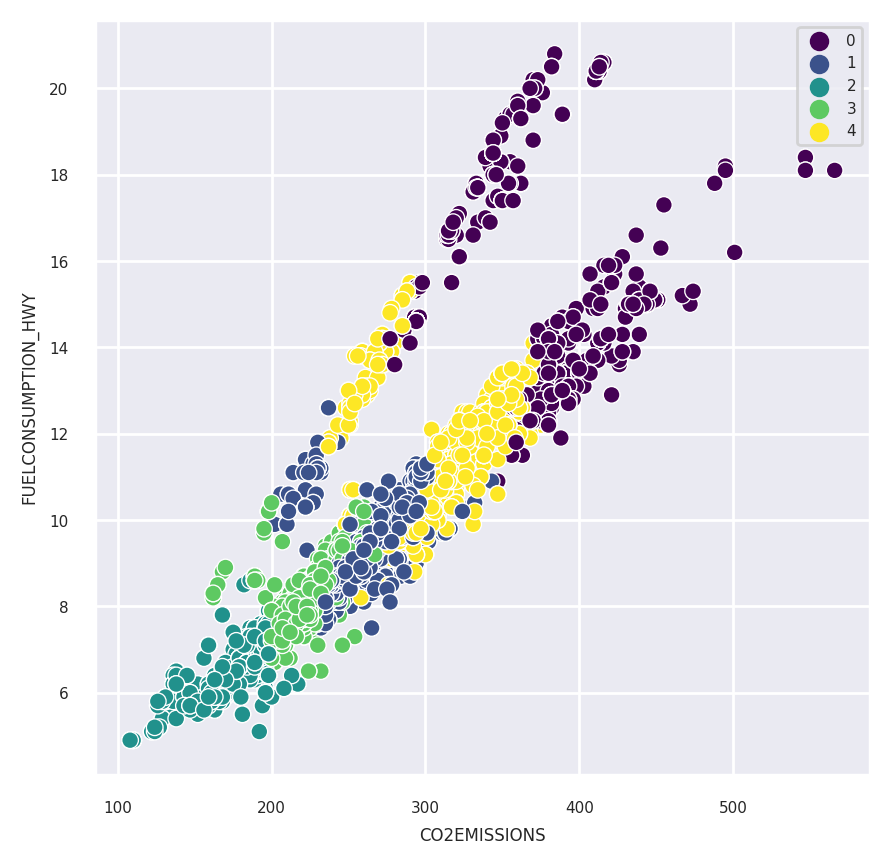

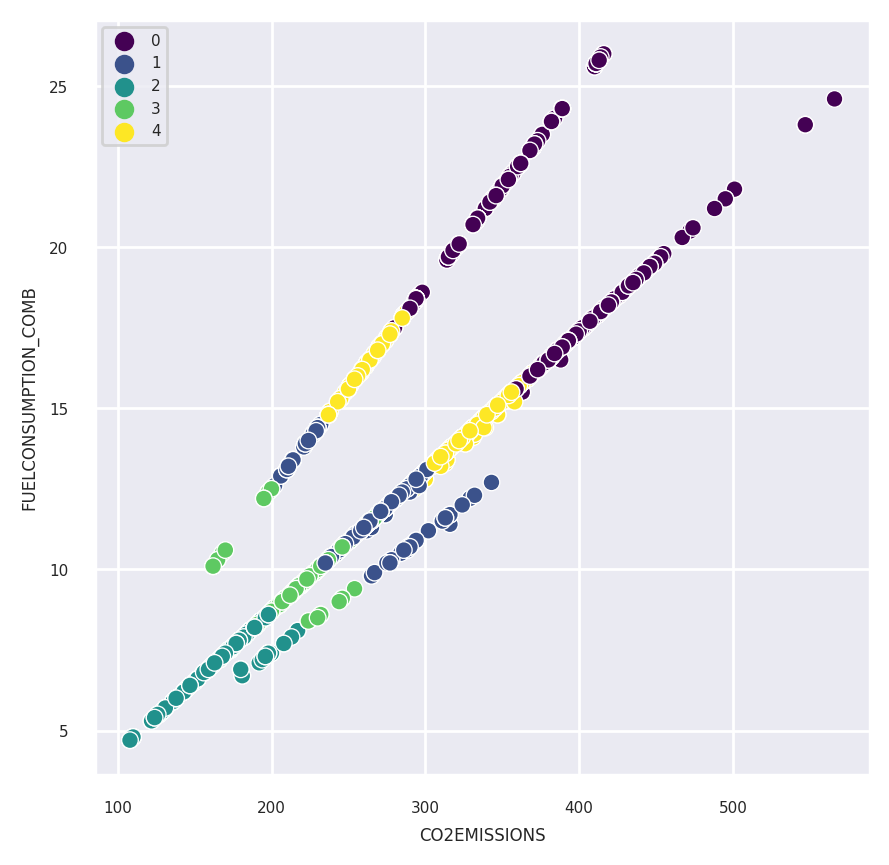

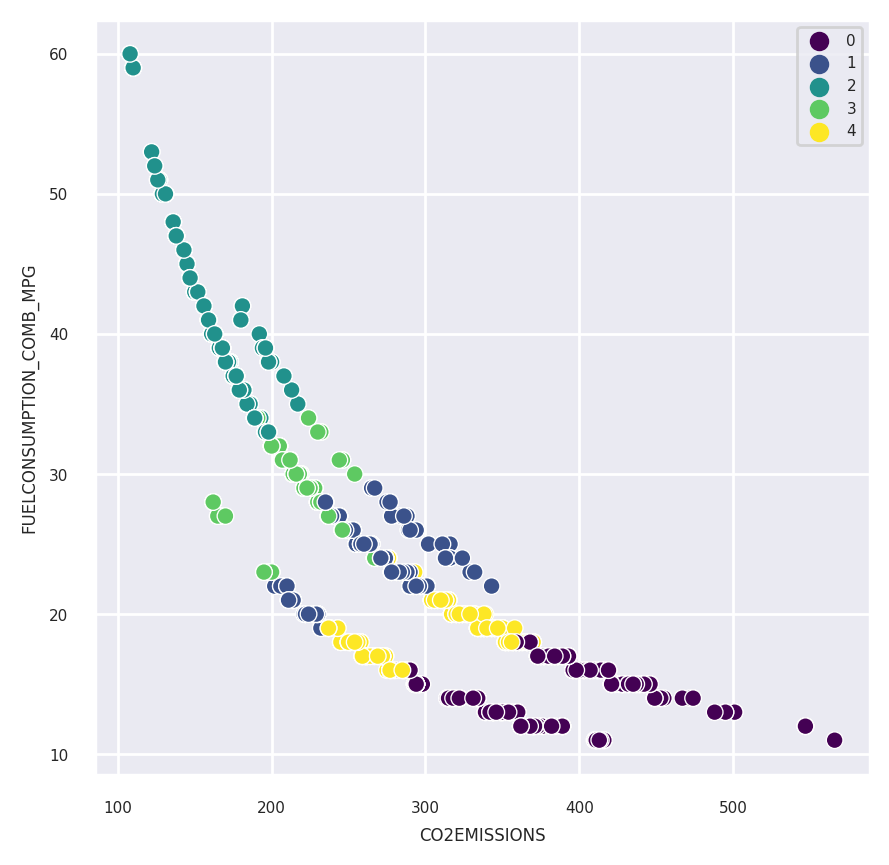

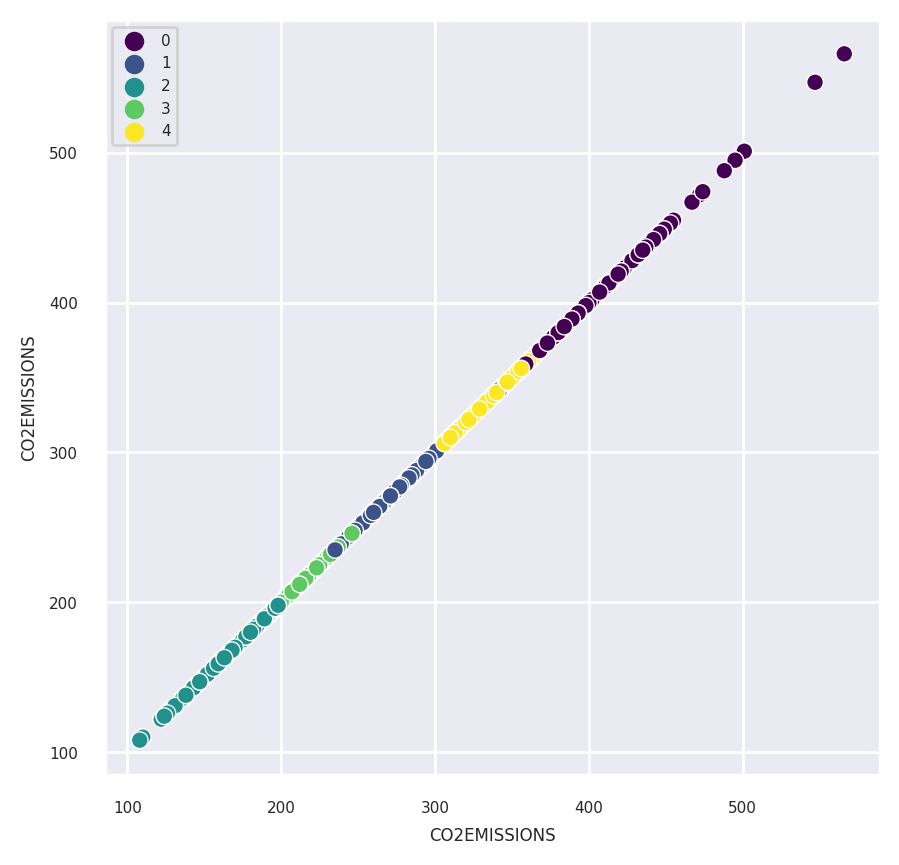

In [ ]:
# ploting the attributes to see how they affect the clusters formed
for col1 in my_numeric_df.columns:
  for col2 in my_numeric_df.columns:
    plt.figure(figsize = (5,5),dpi = 200)
    sns.set(font_scale=0.5)
    sns.scatterplot(data = my_numeric_df, x = my_numeric_df[col1],y = my_numeric_df[col2],hue=cluster_labels, palette = 'viridis')
    plt.show()

# clustering the numerical attributes base on the categorical values
1. Fuel Type

In [ ]:
my_object_df

,MAKE,MODEL,VEHICLECLASS,TRANSMISSION,FUELTYPE
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z
...,...,...,...,...,...
5354,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5355,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5356,VOLVO,XC70 AWD,SUV - SMALL,AS6,X
5357,VOLVO,XC70 AWD,SUV - SMALL,AS6,X


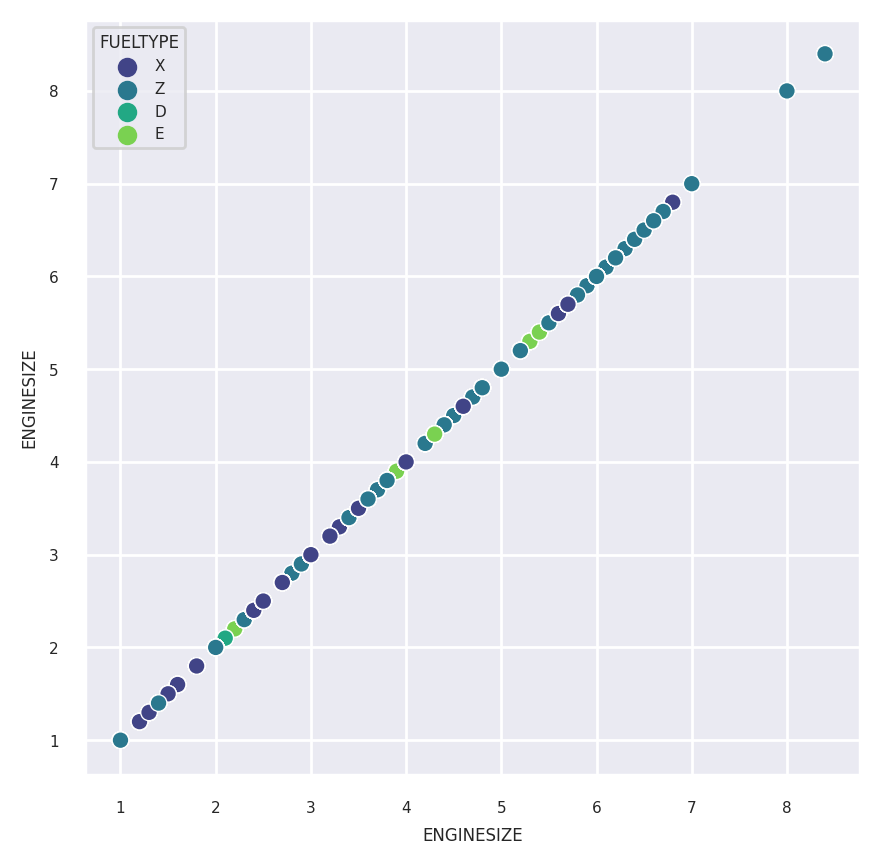

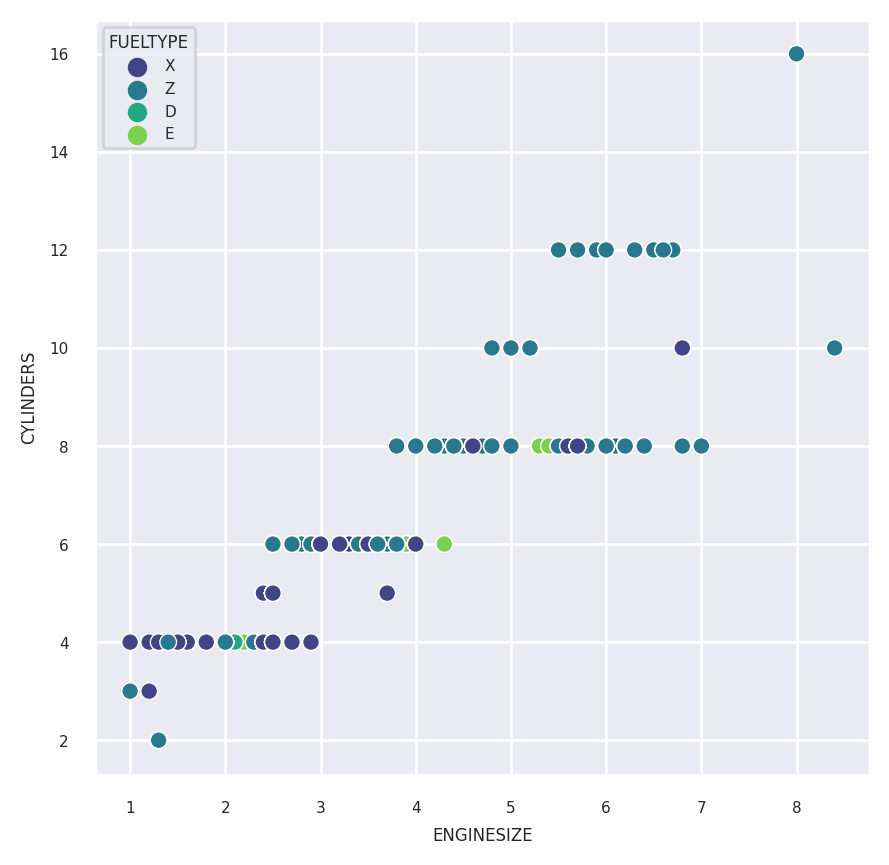

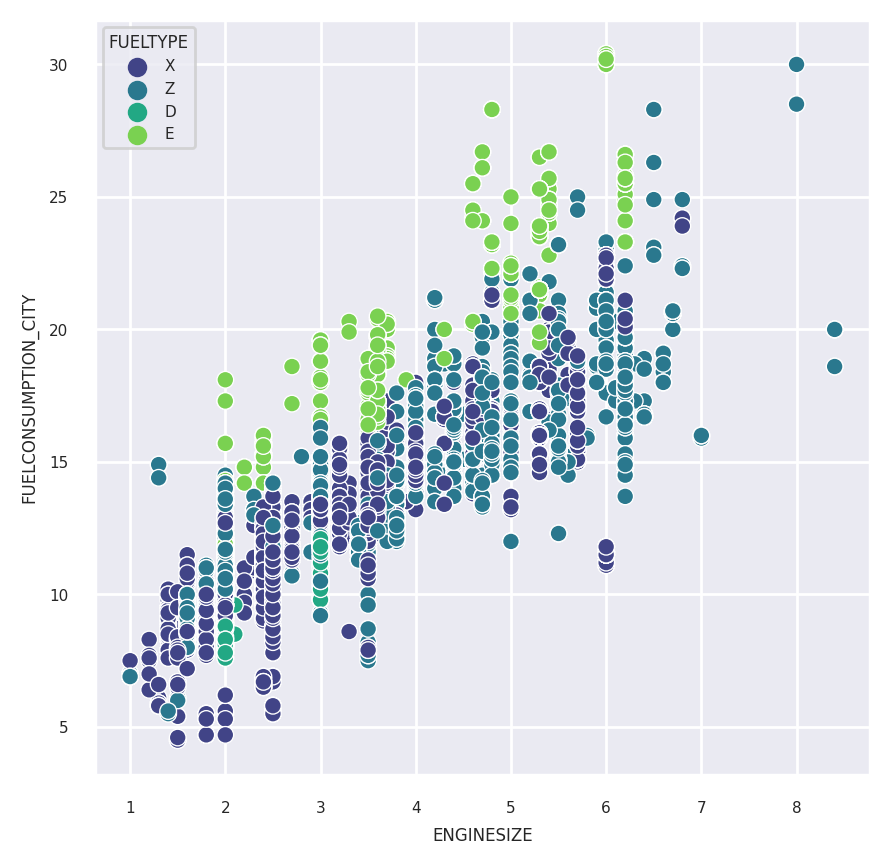

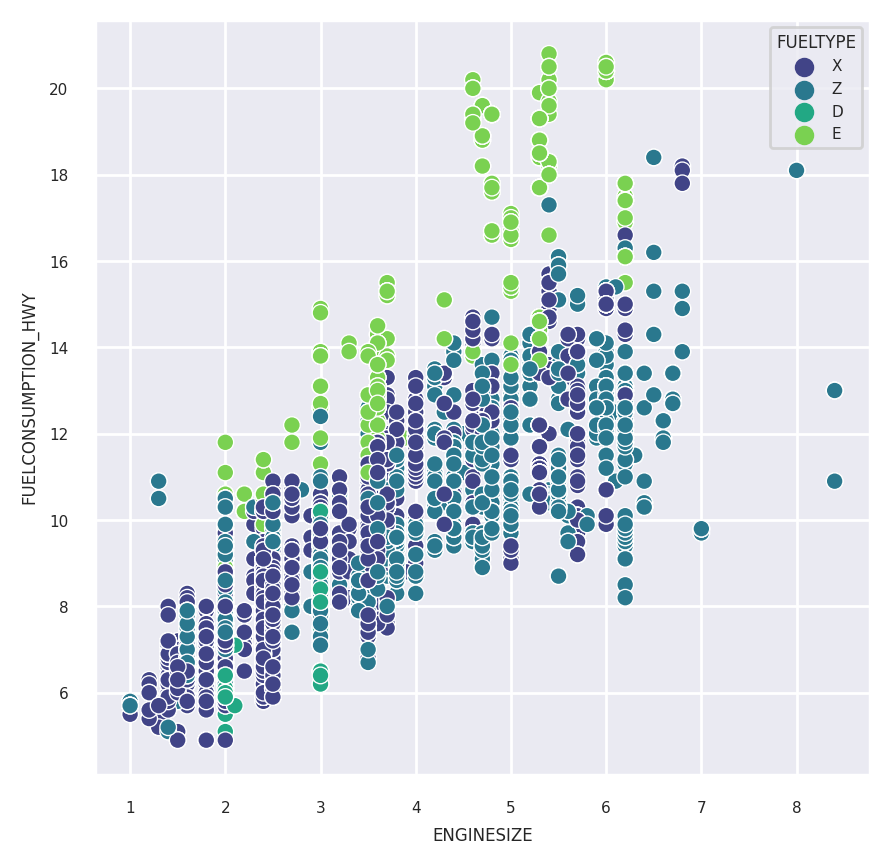

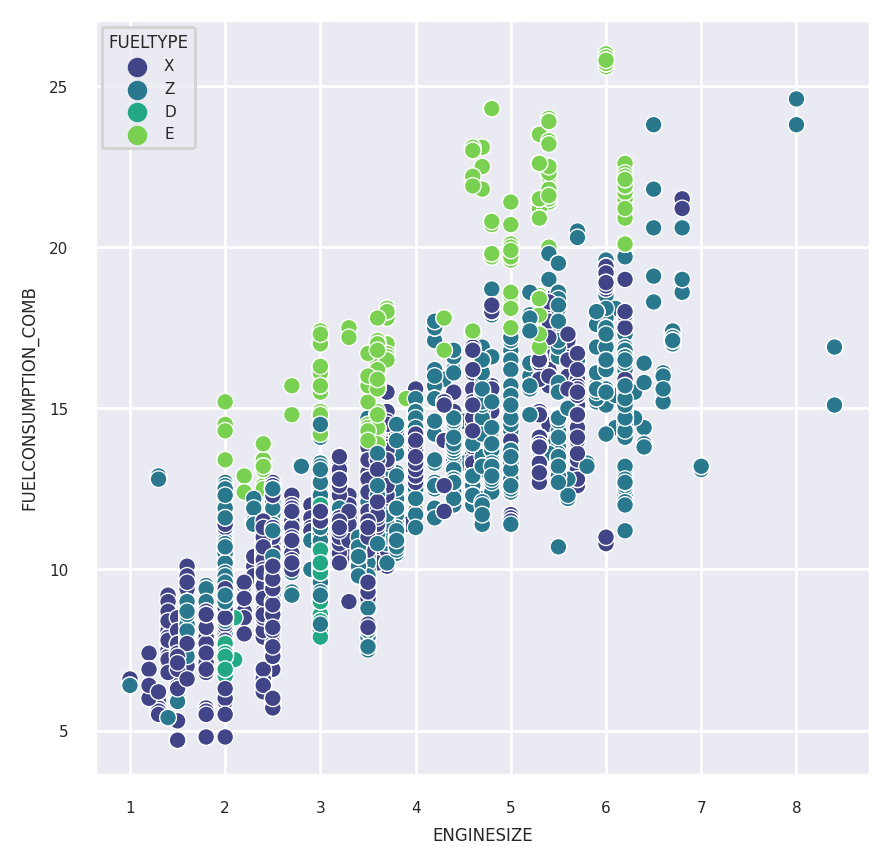

...

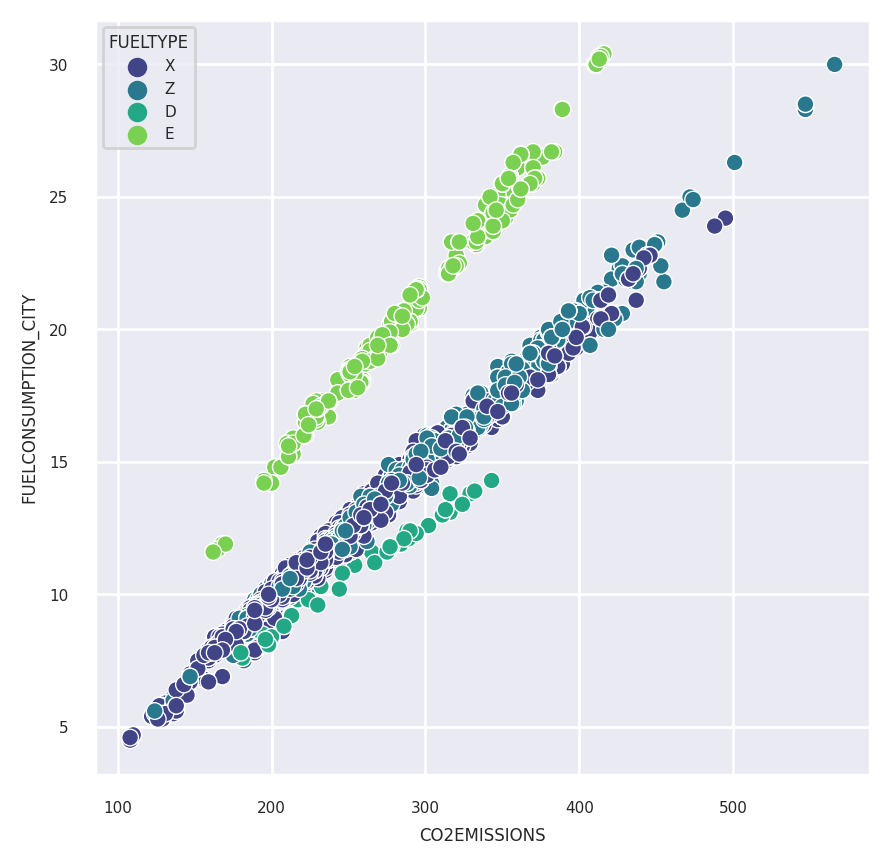

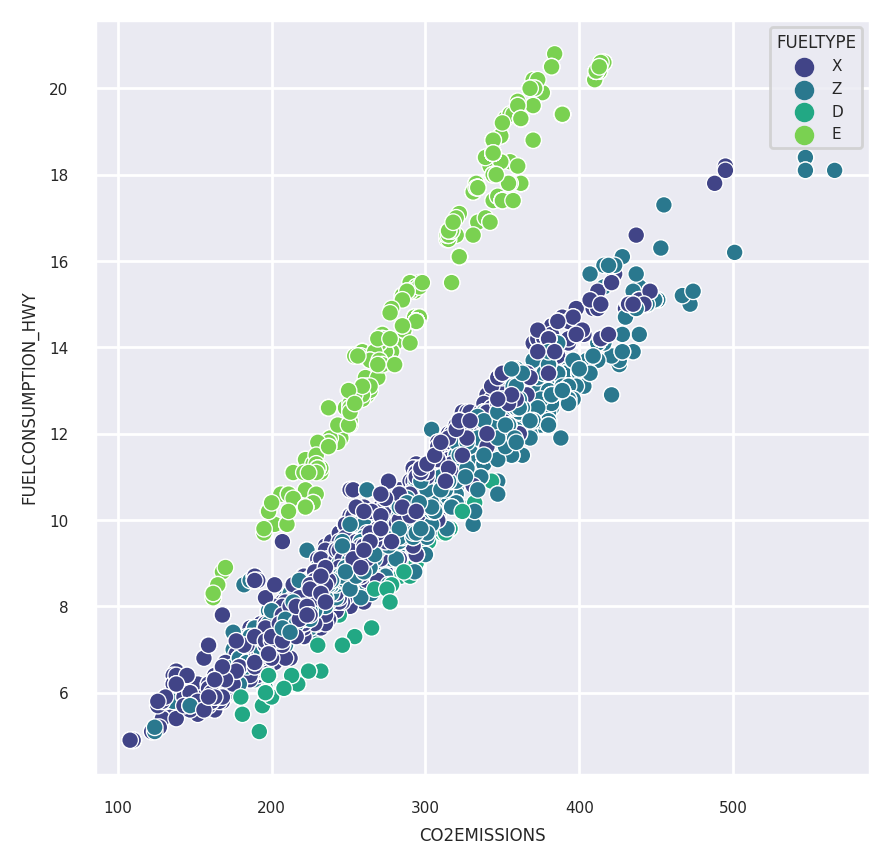

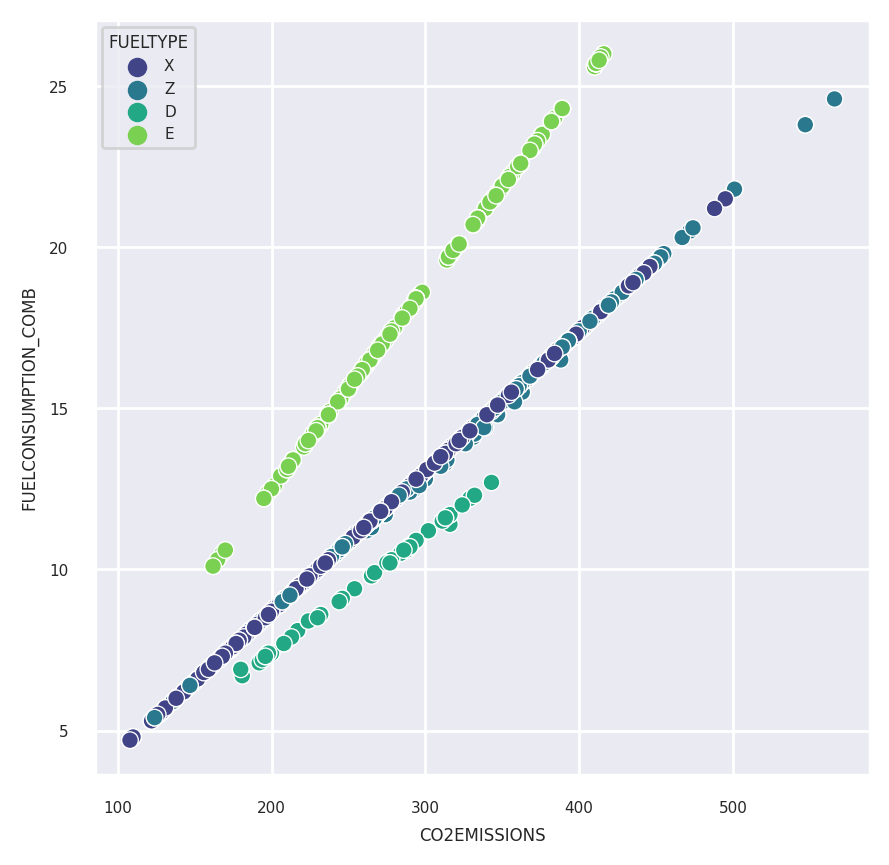

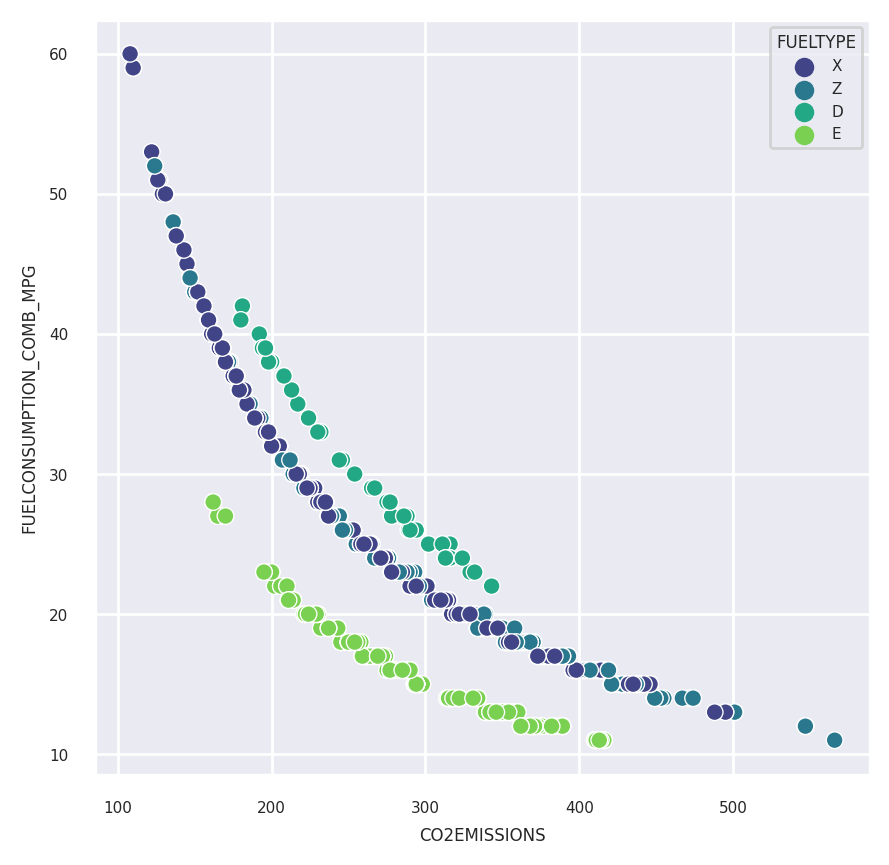

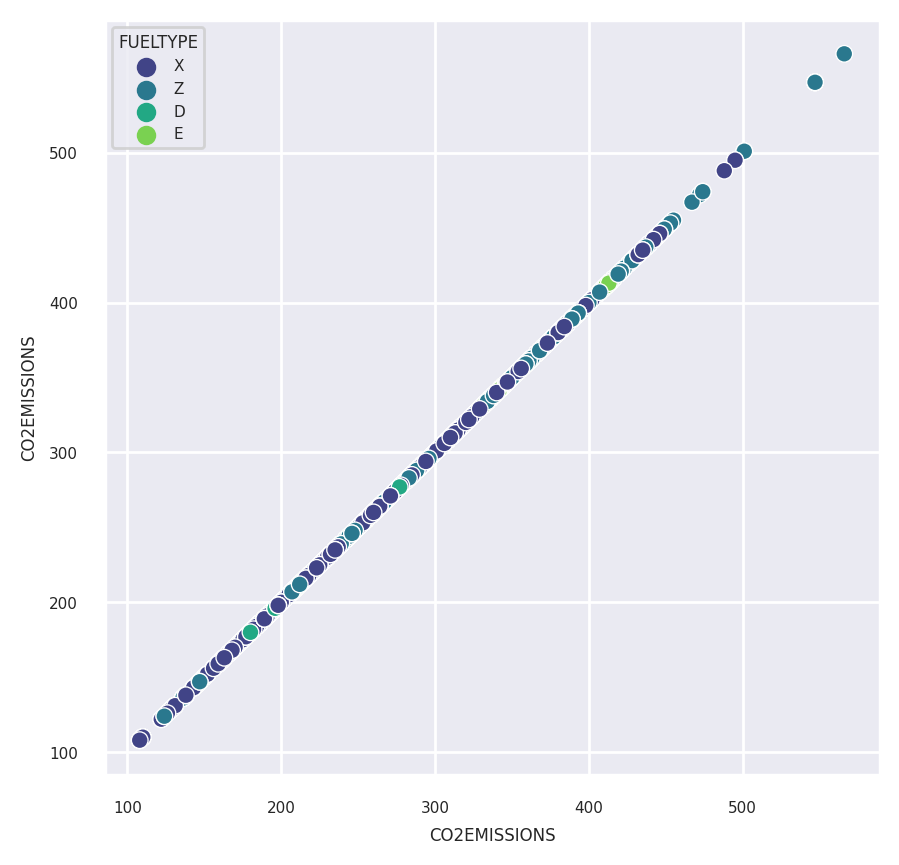

In [ ]:
# clustering the numerical attributes base on the categorical values
for col1 in my_numeric_df.columns:
  for col2 in my_numeric_df.columns:
    plt.figure(figsize = (5,5),dpi = 200)
    sns.set(font_scale=0.5)
    sns.scatterplot(data = my_numeric_df, x = my_numeric_df[col1],y = my_numeric_df[col2],hue=my_object_df.FUELTYPE, palette = 'viridis')
    plt.show()

2. VEHICLECLASS

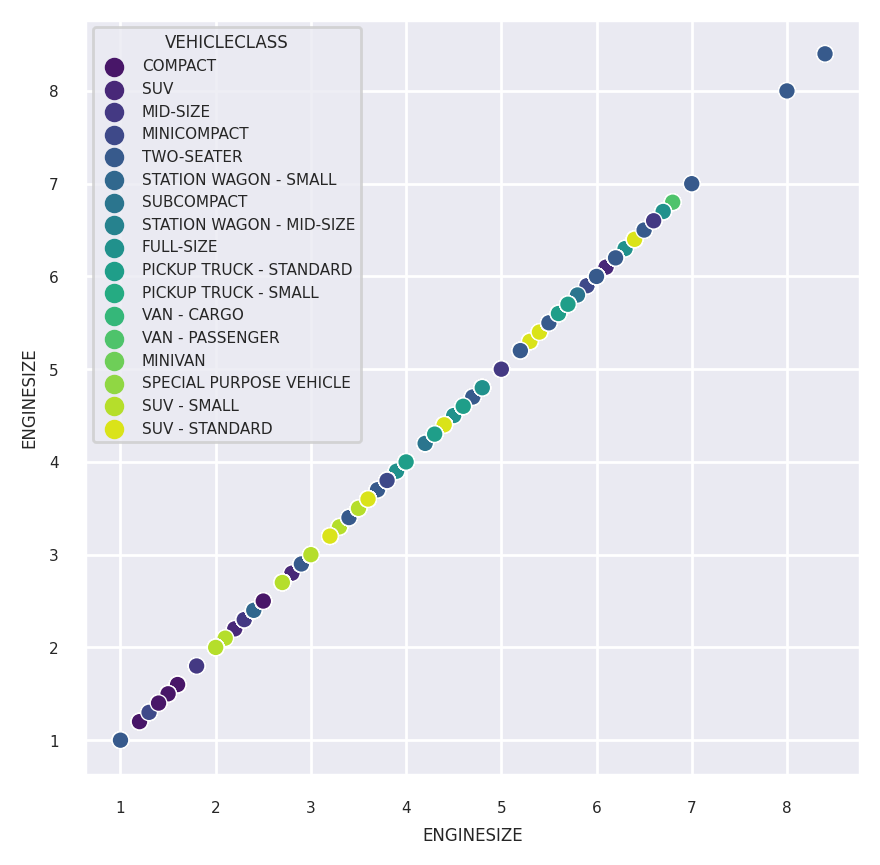

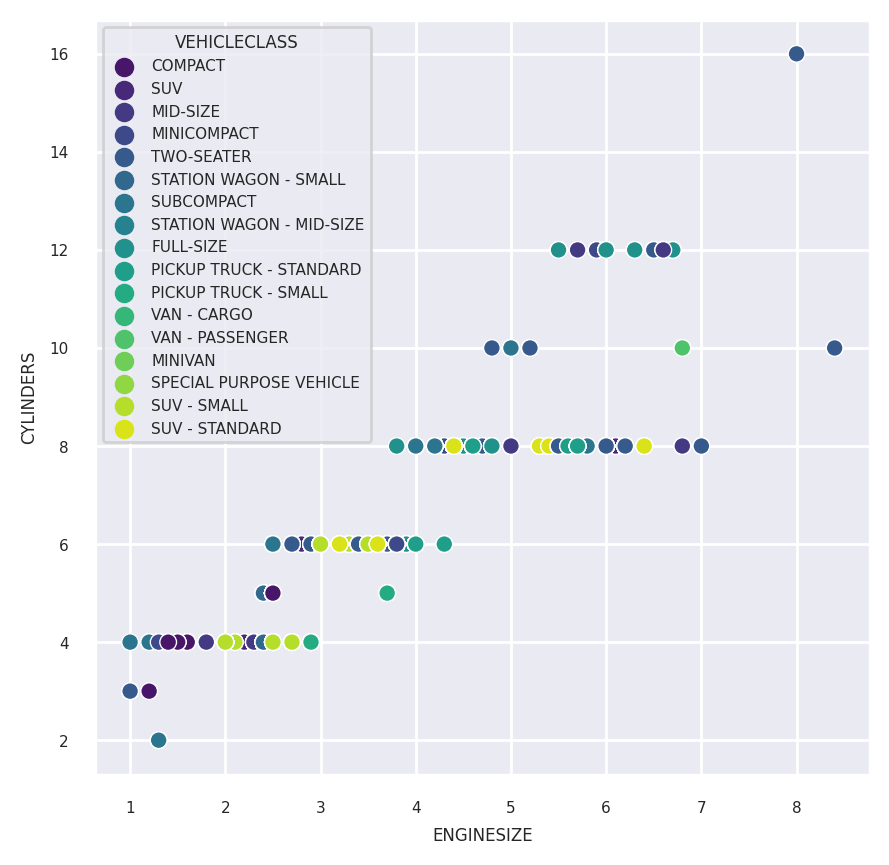

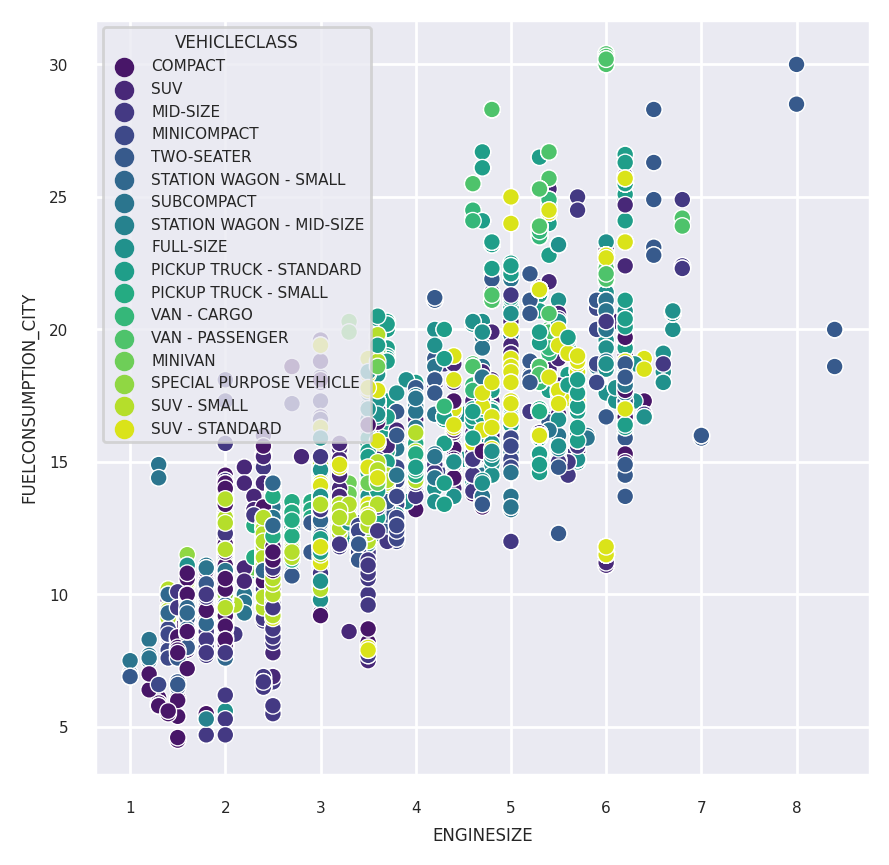

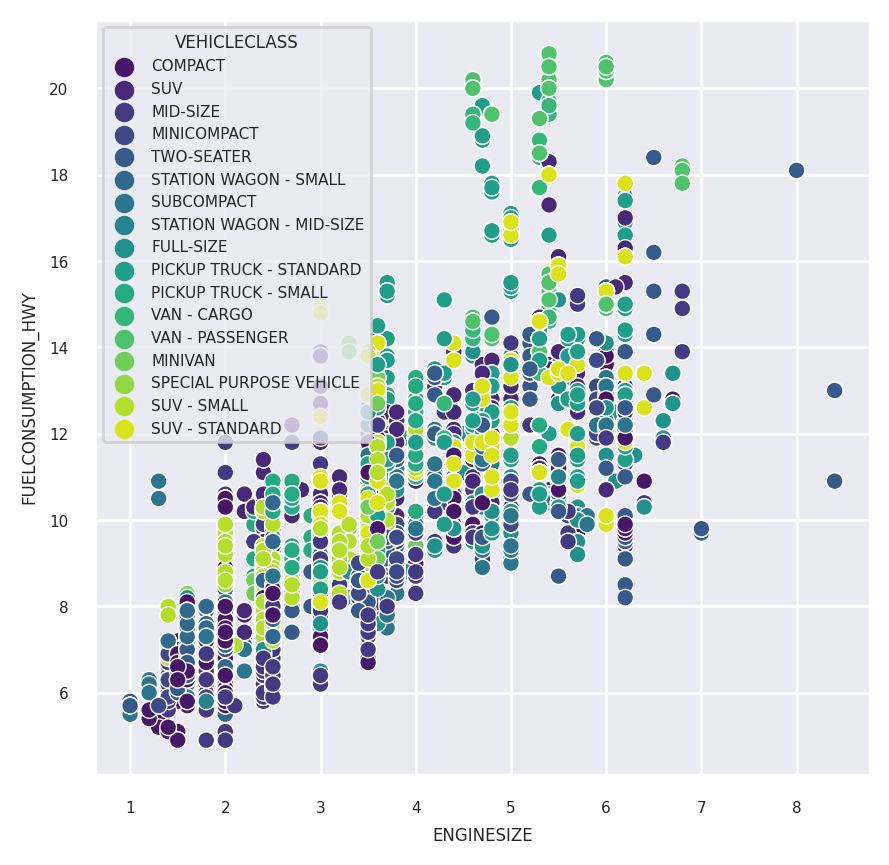

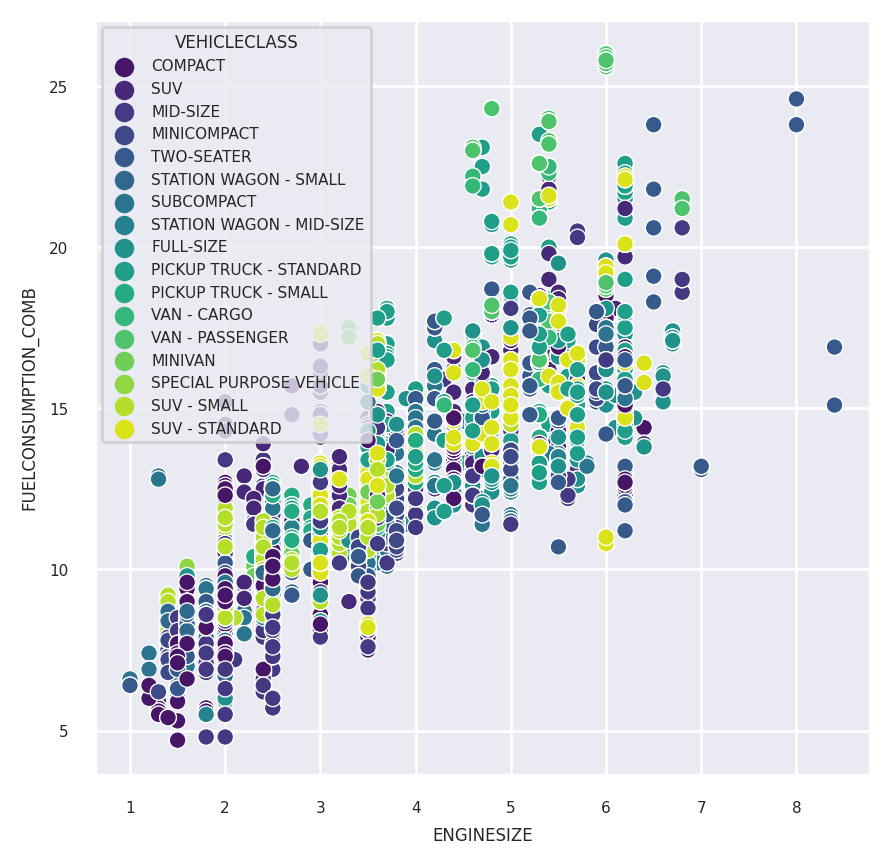

...

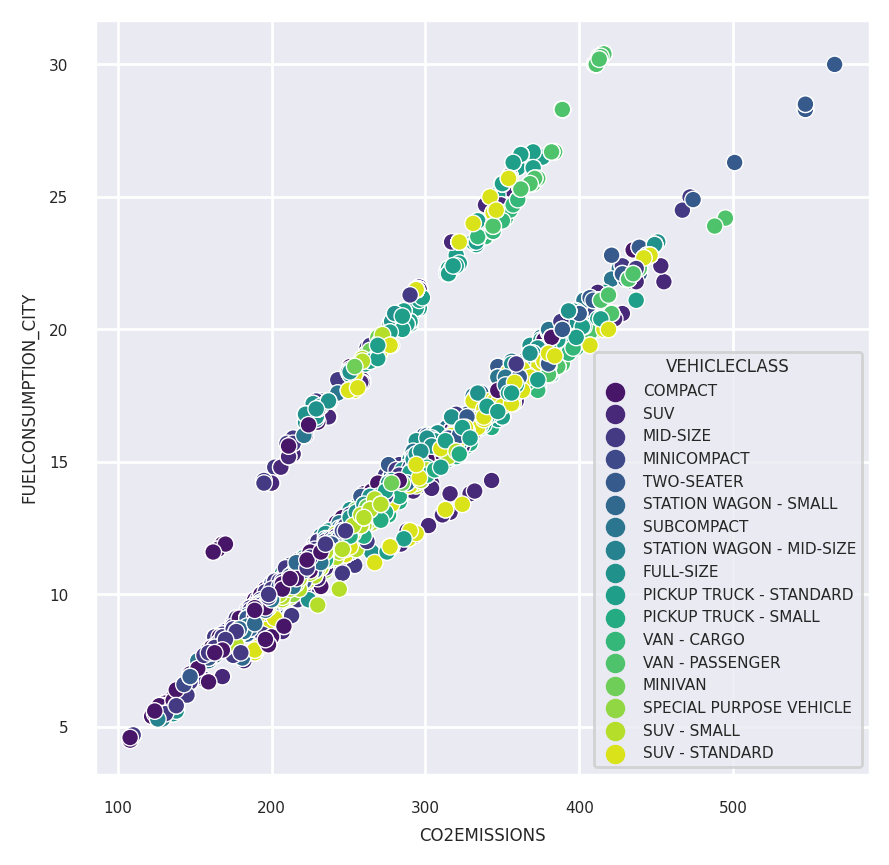

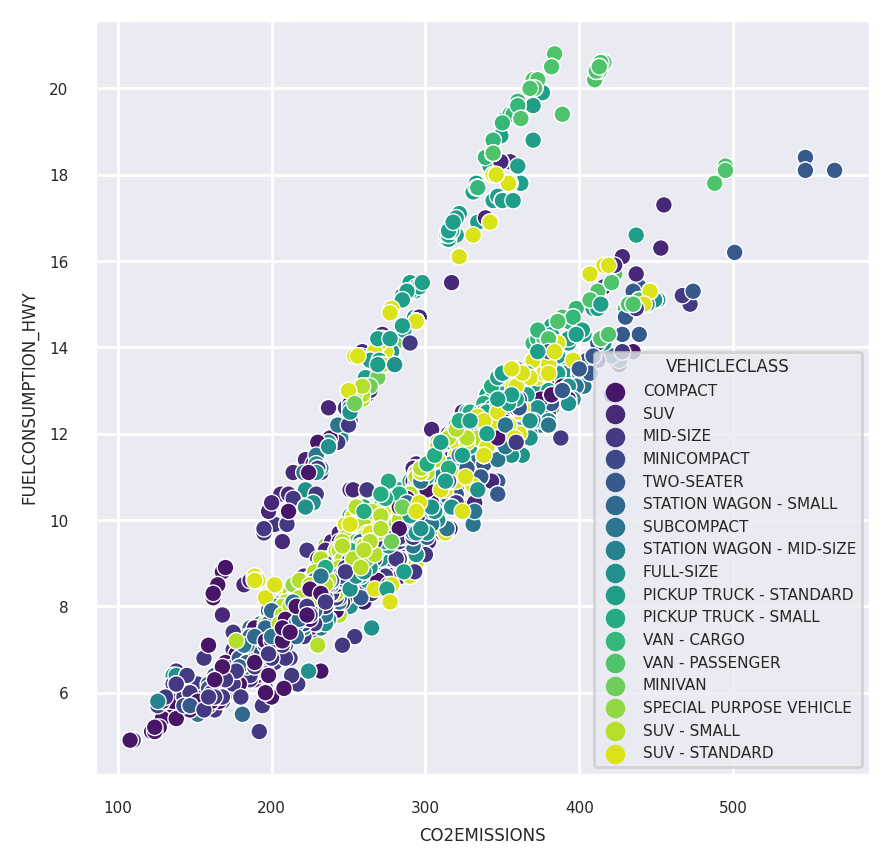

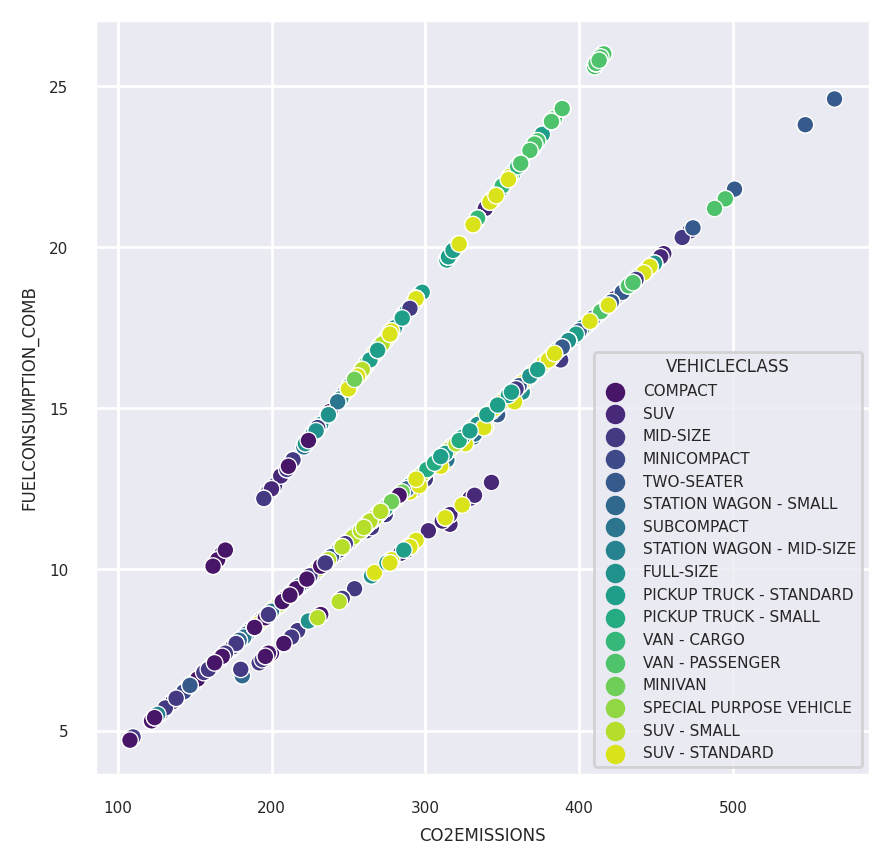

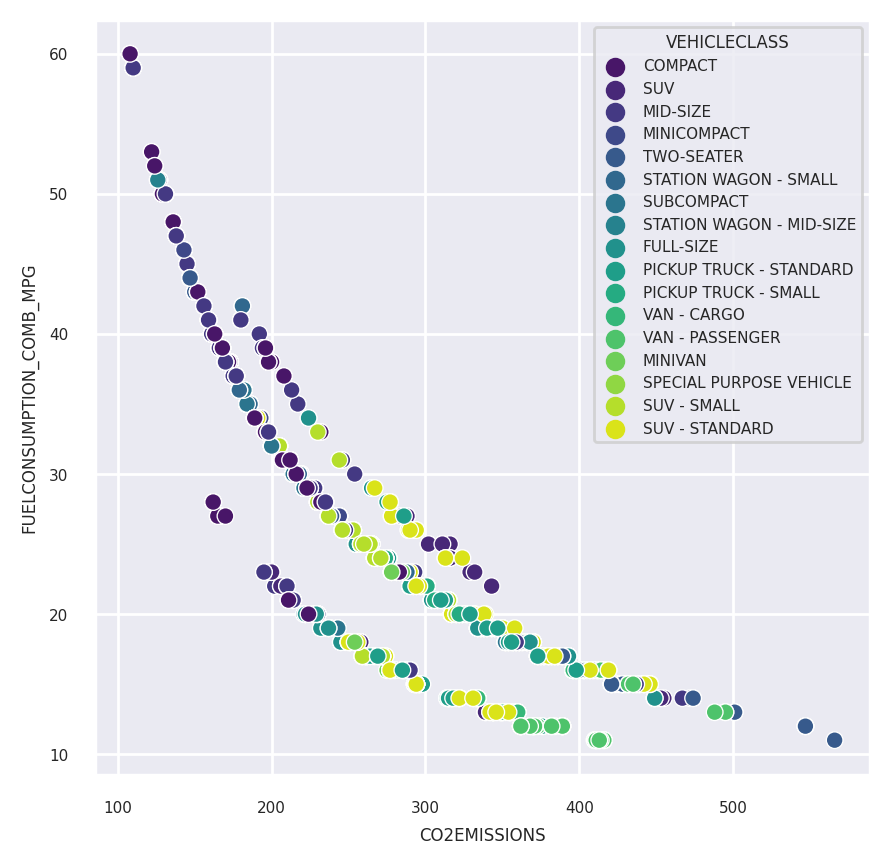

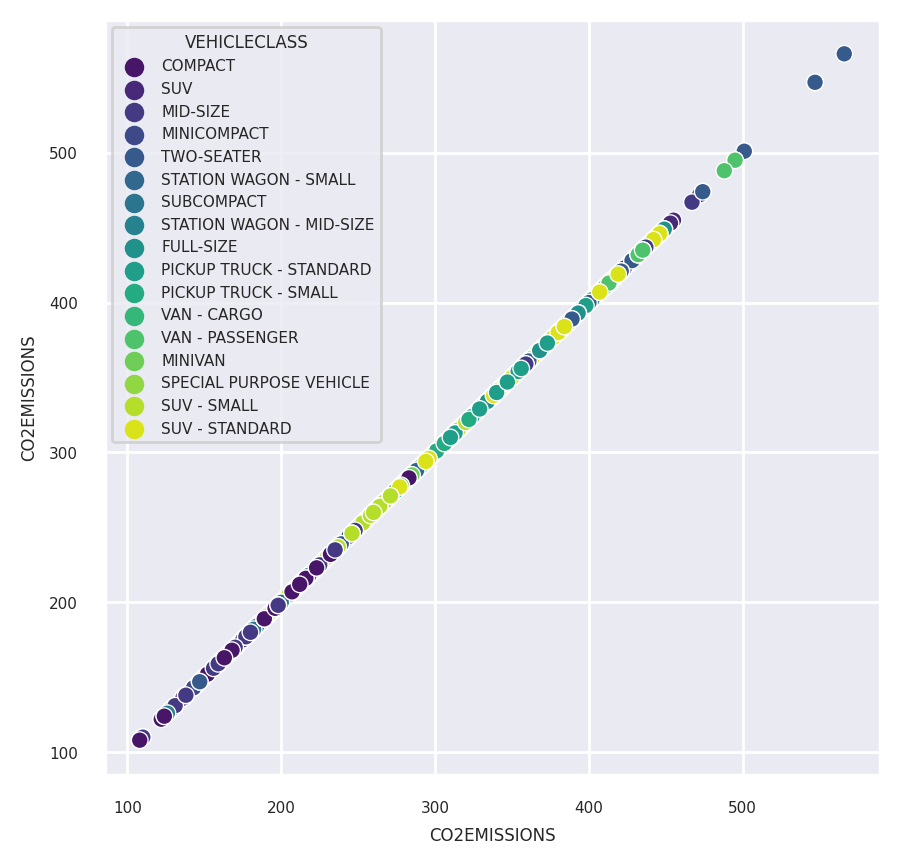

In [ ]:
# clustering the numerical attributes base on the categorical values
for col1 in my_numeric_df.columns:
  for col2 in my_numeric_df.columns:
    plt.figure(figsize = (5,5),dpi = 200)
    sns.set(font_scale=0.5)
    sns.scatterplot(data = my_numeric_df, x = my_numeric_df[col1],y = my_numeric_df[col2],hue=my_object_df.VEHICLECLASS, palette = 'viridis')
    plt.show()